# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [2]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

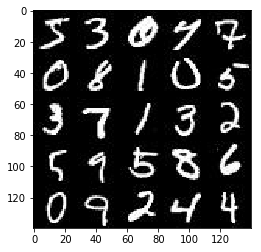

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

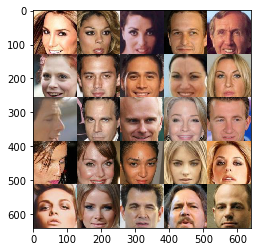

In [4]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 128, 128, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [5]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.0


/Users/kondo.kazuhiro/anaconda/envs/tensorflow/lib/python3.5/site-packages/ipykernel/__main__.py:14: UserWarning: No GPU found. Please use a GPU to train your neural network.


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [74]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    input_images = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels], name='input_images')
    z = tf.placeholder(tf.float32, [None, z_dim], name='z')
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')

    return input_images, z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the generator, tensor logits of the generator).

In [15]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    #print(images)
    alpha=0.2
    
    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse): # finish this
        
        # Input layer is 28x28x3
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 14x14x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 7x7x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)        
        
        
        return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variabes in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [26]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    alpha=0.2
    
    with tf.variable_scope('generator', reuse=(not is_train)):
        
        # First fully connected layer
        x1 = tf.layers.dense(z, 7*7*512)

        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 7, 7, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        # 7x7x512 now
        #print(x1)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=1, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # 7x7x256 now
        #print(x2)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha * x3, x3)
        # 14x14x128 now
        #print(x3)
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 5, strides=2, padding='same')
        # 28x28x3 now
        #print(logits)
        
        out = tf.tanh(logits)
        
        return out

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [30]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    g_model = generator(input_z, out_channel_dim, is_train=True)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [31]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [32]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [92]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    #print(data_shape)
    #print(data_shape[1], data_shape[2])
    #print(data_image_mode)
    #print(z_dim)
    
    tf.reset_default_graph()

    image_channels = 3 if data_image_mode == 'RGB' else 1
    input_real, input_z, tmp = model_inputs(data_shape[1], data_shape[2], image_channels, z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, image_channels)
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)    

    
    sample_z = np.random.uniform(-1, 1, size=(72, z_dim))
    samples, losses = [], []
    steps = 0
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))

                # Run optimizers
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                _ = sess.run(g_opt, feed_dict={input_z: batch_z, input_real: batch_images})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    train_loss_g = g_loss.eval({input_z: batch_z})

                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    show_generator_output(sess, n_images, input_z, image_channels, data_image_mode)

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 0.7115... Generator Loss: 0.8796
Epoch 1/2... Discriminator Loss: 0.3788... Generator Loss: 2.3149
Epoch 1/2... Discriminator Loss: 1.4603... Generator Loss: 1.8066
Epoch 1/2... Discriminator Loss: 1.2145... Generator Loss: 2.1845
Epoch 1/2... Discriminator Loss: 2.0777... Generator Loss: 0.2276
Epoch 1/2... Discriminator Loss: 1.3106... Generator Loss: 0.5842
Epoch 1/2... Discriminator Loss: 0.8169... Generator Loss: 1.8341
Epoch 1/2... Discriminator Loss: 0.6548... Generator Loss: 1.9592
Epoch 1/2... Discriminator Loss: 0.8605... Generator Loss: 1.4974
Epoch 1/2... Discriminator Loss: 1.0536... Generator Loss: 0.5826


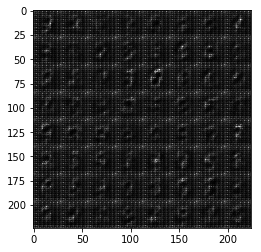

Epoch 1/2... Discriminator Loss: 0.7971... Generator Loss: 3.0367
Epoch 1/2... Discriminator Loss: 0.8043... Generator Loss: 3.1326
Epoch 1/2... Discriminator Loss: 0.3827... Generator Loss: 1.9756
Epoch 1/2... Discriminator Loss: 0.3480... Generator Loss: 1.7694
Epoch 1/2... Discriminator Loss: 0.7141... Generator Loss: 0.9156
Epoch 1/2... Discriminator Loss: 0.4618... Generator Loss: 2.8252
Epoch 1/2... Discriminator Loss: 0.4487... Generator Loss: 1.3076
Epoch 1/2... Discriminator Loss: 0.3463... Generator Loss: 1.5180
Epoch 1/2... Discriminator Loss: 0.6186... Generator Loss: 1.9762
Epoch 1/2... Discriminator Loss: 1.2264... Generator Loss: 0.5265


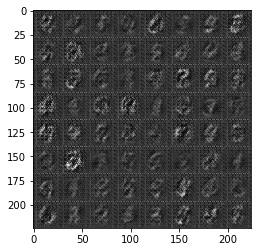

Epoch 1/2... Discriminator Loss: 1.3376... Generator Loss: 0.4596
Epoch 1/2... Discriminator Loss: 0.6464... Generator Loss: 2.4594
Epoch 1/2... Discriminator Loss: 1.2310... Generator Loss: 2.3624
Epoch 1/2... Discriminator Loss: 0.5906... Generator Loss: 2.5541
Epoch 1/2... Discriminator Loss: 0.8370... Generator Loss: 3.7341
Epoch 1/2... Discriminator Loss: 0.4702... Generator Loss: 3.0658
Epoch 1/2... Discriminator Loss: 0.4147... Generator Loss: 1.4948
Epoch 1/2... Discriminator Loss: 0.2890... Generator Loss: 2.1240
Epoch 1/2... Discriminator Loss: 0.5197... Generator Loss: 2.3937
Epoch 1/2... Discriminator Loss: 0.3055... Generator Loss: 1.8578


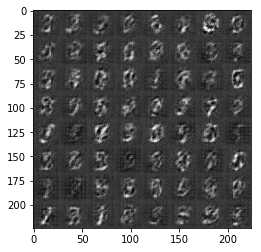

Epoch 1/2... Discriminator Loss: 0.3982... Generator Loss: 1.5035
Epoch 1/2... Discriminator Loss: 0.9911... Generator Loss: 3.4578
Epoch 1/2... Discriminator Loss: 0.4357... Generator Loss: 1.5428
Epoch 1/2... Discriminator Loss: 0.3935... Generator Loss: 1.8446
Epoch 1/2... Discriminator Loss: 0.3266... Generator Loss: 2.8335
Epoch 1/2... Discriminator Loss: 0.3245... Generator Loss: 1.9102
Epoch 1/2... Discriminator Loss: 1.2215... Generator Loss: 4.6467
Epoch 1/2... Discriminator Loss: 0.3058... Generator Loss: 2.1328
Epoch 1/2... Discriminator Loss: 0.3244... Generator Loss: 1.8367
Epoch 1/2... Discriminator Loss: 0.5158... Generator Loss: 1.1190


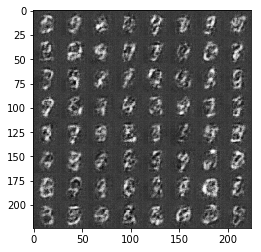

Epoch 1/2... Discriminator Loss: 0.5377... Generator Loss: 2.5565
Epoch 1/2... Discriminator Loss: 0.3372... Generator Loss: 1.5518
Epoch 1/2... Discriminator Loss: 1.0116... Generator Loss: 4.2131
Epoch 1/2... Discriminator Loss: 0.3240... Generator Loss: 1.7169
Epoch 1/2... Discriminator Loss: 0.2001... Generator Loss: 2.3188
Epoch 1/2... Discriminator Loss: 0.2471... Generator Loss: 2.4117
Epoch 2/2... Discriminator Loss: 0.3600... Generator Loss: 1.5024
Epoch 2/2... Discriminator Loss: 0.2438... Generator Loss: 2.5313
Epoch 2/2... Discriminator Loss: 0.2268... Generator Loss: 2.0839
Epoch 2/2... Discriminator Loss: 0.3851... Generator Loss: 1.4649


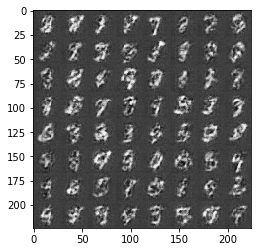

Epoch 2/2... Discriminator Loss: 0.1831... Generator Loss: 2.4349
Epoch 2/2... Discriminator Loss: 0.2181... Generator Loss: 2.0820
Epoch 2/2... Discriminator Loss: 0.2535... Generator Loss: 1.8715
Epoch 2/2... Discriminator Loss: 0.8057... Generator Loss: 4.3812
Epoch 2/2... Discriminator Loss: 0.3264... Generator Loss: 2.0359
Epoch 2/2... Discriminator Loss: 0.3946... Generator Loss: 1.4236
Epoch 2/2... Discriminator Loss: 0.3128... Generator Loss: 1.6763
Epoch 2/2... Discriminator Loss: 0.2297... Generator Loss: 2.2823
Epoch 2/2... Discriminator Loss: 0.4698... Generator Loss: 1.1980
Epoch 2/2... Discriminator Loss: 0.1988... Generator Loss: 2.1025


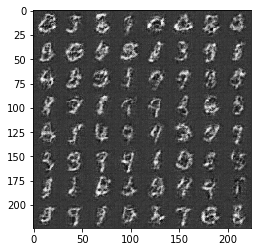

Epoch 2/2... Discriminator Loss: 0.2517... Generator Loss: 1.8807
Epoch 2/2... Discriminator Loss: 0.2040... Generator Loss: 2.1252
Epoch 2/2... Discriminator Loss: 0.1513... Generator Loss: 2.9861
Epoch 2/2... Discriminator Loss: 0.1476... Generator Loss: 2.7280
Epoch 2/2... Discriminator Loss: 0.1478... Generator Loss: 3.0562
Epoch 2/2... Discriminator Loss: 0.2045... Generator Loss: 2.1002
Epoch 2/2... Discriminator Loss: 1.3262... Generator Loss: 0.4781
Epoch 2/2... Discriminator Loss: 0.5703... Generator Loss: 1.4084
Epoch 2/2... Discriminator Loss: 0.4173... Generator Loss: 1.4259
Epoch 2/2... Discriminator Loss: 0.3993... Generator Loss: 1.5678


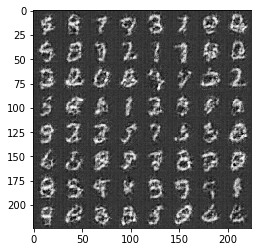

Epoch 2/2... Discriminator Loss: 0.2570... Generator Loss: 2.0338
Epoch 2/2... Discriminator Loss: 0.1908... Generator Loss: 2.2561
Epoch 2/2... Discriminator Loss: 0.3386... Generator Loss: 1.5650
Epoch 2/2... Discriminator Loss: 0.0937... Generator Loss: 3.3622
Epoch 2/2... Discriminator Loss: 0.2542... Generator Loss: 1.8108
Epoch 2/2... Discriminator Loss: 0.1956... Generator Loss: 2.0461
Epoch 2/2... Discriminator Loss: 0.0941... Generator Loss: 2.8333
Epoch 2/2... Discriminator Loss: 0.1994... Generator Loss: 2.2702
Epoch 2/2... Discriminator Loss: 6.3336... Generator Loss: 6.7799
Epoch 2/2... Discriminator Loss: 0.3178... Generator Loss: 2.2121


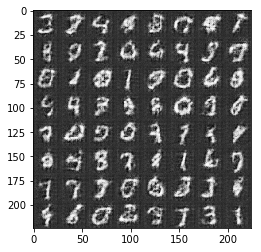

Epoch 2/2... Discriminator Loss: 0.3373... Generator Loss: 1.6914
Epoch 2/2... Discriminator Loss: 0.3191... Generator Loss: 1.7131
Epoch 2/2... Discriminator Loss: 0.2297... Generator Loss: 1.9628
Epoch 2/2... Discriminator Loss: 0.1714... Generator Loss: 2.5758
Epoch 2/2... Discriminator Loss: 0.3677... Generator Loss: 1.4033
Epoch 2/2... Discriminator Loss: 0.2611... Generator Loss: 1.7468
Epoch 2/2... Discriminator Loss: 0.2605... Generator Loss: 1.8380
Epoch 2/2... Discriminator Loss: 0.0894... Generator Loss: 3.2935
Epoch 2/2... Discriminator Loss: 0.7305... Generator Loss: 0.7732
Epoch 2/2... Discriminator Loss: 1.1622... Generator Loss: 1.9697


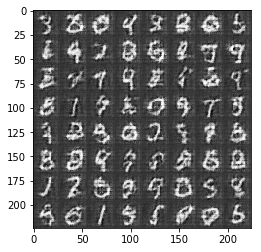

Epoch 2/2... Discriminator Loss: 0.7754... Generator Loss: 0.7365
Epoch 2/2... Discriminator Loss: 0.3819... Generator Loss: 2.3308
Epoch 2/2... Discriminator Loss: 0.3568... Generator Loss: 1.7560


IndexError: list index out of range

In [93]:
batch_size = 128
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

print_every=10
show_every=100
n_images=72

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1... Discriminator Loss: 6.4824... Generator Loss: 0.0023
Epoch 1/1... Discriminator Loss: 5.4088... Generator Loss: 0.0071
Epoch 1/1... Discriminator Loss: 3.6920... Generator Loss: 0.0664
Epoch 1/1... Discriminator Loss: 2.9111... Generator Loss: 0.2259
Epoch 1/1... Discriminator Loss: 2.6109... Generator Loss: 0.2198
Epoch 1/1... Discriminator Loss: 2.3294... Generator Loss: 0.2384
Epoch 1/1... Discriminator Loss: 2.3888... Generator Loss: 0.2064
Epoch 1/1... Discriminator Loss: 1.8618... Generator Loss: 0.4515
Epoch 1/1... Discriminator Loss: 1.9147... Generator Loss: 0.4299
Epoch 1/1... Discriminator Loss: 2.0612... Generator Loss: 0.3249


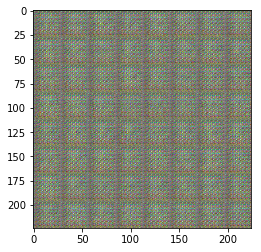

Epoch 1/1... Discriminator Loss: 1.3881... Generator Loss: 0.8000
Epoch 1/1... Discriminator Loss: 1.5543... Generator Loss: 0.5344
Epoch 1/1... Discriminator Loss: 1.3172... Generator Loss: 0.7741
Epoch 1/1... Discriminator Loss: 1.4930... Generator Loss: 0.6271
Epoch 1/1... Discriminator Loss: 0.9195... Generator Loss: 1.0875
Epoch 1/1... Discriminator Loss: 1.0039... Generator Loss: 1.0008
Epoch 1/1... Discriminator Loss: 0.7098... Generator Loss: 1.2941
Epoch 1/1... Discriminator Loss: 1.0867... Generator Loss: 0.7483
Epoch 1/1... Discriminator Loss: 0.4057... Generator Loss: 2.3127
Epoch 1/1... Discriminator Loss: 1.2091... Generator Loss: 0.5535


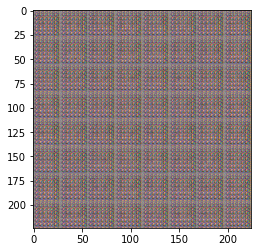

Epoch 1/1... Discriminator Loss: 0.4997... Generator Loss: 3.0428
Epoch 1/1... Discriminator Loss: 1.1128... Generator Loss: 0.7427
Epoch 1/1... Discriminator Loss: 0.7974... Generator Loss: 1.1905
Epoch 1/1... Discriminator Loss: 0.6521... Generator Loss: 1.5552
Epoch 1/1... Discriminator Loss: 1.2518... Generator Loss: 0.6180
Epoch 1/1... Discriminator Loss: 0.8469... Generator Loss: 2.9873
Epoch 1/1... Discriminator Loss: 1.7445... Generator Loss: 0.2691
Epoch 1/1... Discriminator Loss: 0.5973... Generator Loss: 4.8566
Epoch 1/1... Discriminator Loss: 0.4099... Generator Loss: 2.0714
Epoch 1/1... Discriminator Loss: 2.1173... Generator Loss: 0.1717


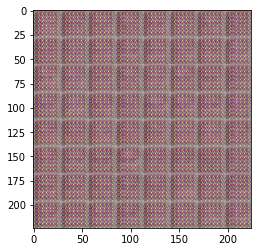

Epoch 1/1... Discriminator Loss: 0.9485... Generator Loss: 5.9887
Epoch 1/1... Discriminator Loss: 0.5403... Generator Loss: 4.4528
Epoch 1/1... Discriminator Loss: 0.9582... Generator Loss: 0.6846
Epoch 1/1... Discriminator Loss: 0.4444... Generator Loss: 1.8856
Epoch 1/1... Discriminator Loss: 0.4337... Generator Loss: 1.7880
Epoch 1/1... Discriminator Loss: 1.5898... Generator Loss: 0.3885
Epoch 1/1... Discriminator Loss: 0.8594... Generator Loss: 2.9078
Epoch 1/1... Discriminator Loss: 2.0703... Generator Loss: 0.2639
Epoch 1/1... Discriminator Loss: 1.6000... Generator Loss: 3.7876
Epoch 1/1... Discriminator Loss: 0.8418... Generator Loss: 1.0448


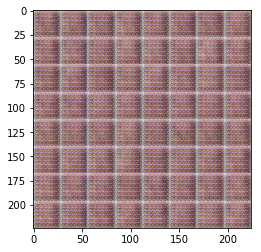

Epoch 1/1... Discriminator Loss: 0.7043... Generator Loss: 1.1900
Epoch 1/1... Discriminator Loss: 0.4046... Generator Loss: 3.0273
Epoch 1/1... Discriminator Loss: 0.6018... Generator Loss: 1.3489
Epoch 1/1... Discriminator Loss: 0.4811... Generator Loss: 1.6615
Epoch 1/1... Discriminator Loss: 0.6721... Generator Loss: 1.5329
Epoch 1/1... Discriminator Loss: 0.6383... Generator Loss: 1.5629
Epoch 1/1... Discriminator Loss: 1.1678... Generator Loss: 1.0454
Epoch 1/1... Discriminator Loss: 1.1091... Generator Loss: 1.1481
Epoch 1/1... Discriminator Loss: 1.5306... Generator Loss: 0.9448
Epoch 1/1... Discriminator Loss: 1.3025... Generator Loss: 1.1619


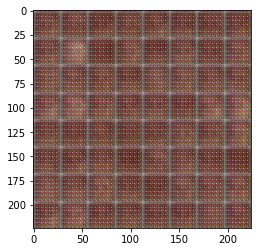

Epoch 1/1... Discriminator Loss: 1.1732... Generator Loss: 0.7148
Epoch 1/1... Discriminator Loss: 0.8678... Generator Loss: 2.1498
Epoch 1/1... Discriminator Loss: 1.1754... Generator Loss: 0.6591
Epoch 1/1... Discriminator Loss: 0.9520... Generator Loss: 1.8219
Epoch 1/1... Discriminator Loss: 1.4350... Generator Loss: 1.0441
Epoch 1/1... Discriminator Loss: 1.4807... Generator Loss: 0.8010
Epoch 1/1... Discriminator Loss: 1.0916... Generator Loss: 1.9667
Epoch 1/1... Discriminator Loss: 0.9303... Generator Loss: 0.8660
Epoch 1/1... Discriminator Loss: 0.5907... Generator Loss: 1.5835
Epoch 1/1... Discriminator Loss: 0.6968... Generator Loss: 1.6370


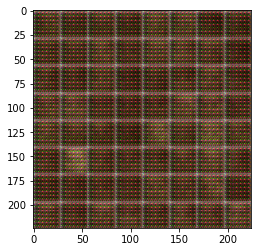

Epoch 1/1... Discriminator Loss: 0.8454... Generator Loss: 1.1095
Epoch 1/1... Discriminator Loss: 0.9346... Generator Loss: 1.0814
Epoch 1/1... Discriminator Loss: 0.9085... Generator Loss: 1.7595
Epoch 1/1... Discriminator Loss: 1.4796... Generator Loss: 0.4006
Epoch 1/1... Discriminator Loss: 1.0694... Generator Loss: 2.7604
Epoch 1/1... Discriminator Loss: 0.8259... Generator Loss: 0.8514
Epoch 1/1... Discriminator Loss: 0.7063... Generator Loss: 1.1589
Epoch 1/1... Discriminator Loss: 0.6729... Generator Loss: 1.6197
Epoch 1/1... Discriminator Loss: 0.8991... Generator Loss: 0.8161
Epoch 1/1... Discriminator Loss: 0.7386... Generator Loss: 1.7046


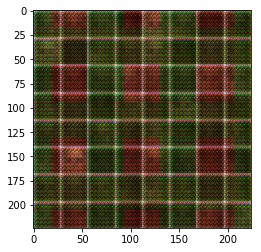

Epoch 1/1... Discriminator Loss: 0.8868... Generator Loss: 0.9102
Epoch 1/1... Discriminator Loss: 0.7220... Generator Loss: 1.8974
Epoch 1/1... Discriminator Loss: 0.9013... Generator Loss: 0.7489
Epoch 1/1... Discriminator Loss: 0.6348... Generator Loss: 2.1159
Epoch 1/1... Discriminator Loss: 0.5504... Generator Loss: 1.2848
Epoch 1/1... Discriminator Loss: 0.5034... Generator Loss: 1.6259
Epoch 1/1... Discriminator Loss: 0.7588... Generator Loss: 0.9722
Epoch 1/1... Discriminator Loss: 0.6118... Generator Loss: 2.3156
Epoch 1/1... Discriminator Loss: 0.7961... Generator Loss: 0.8275
Epoch 1/1... Discriminator Loss: 0.6748... Generator Loss: 2.6393


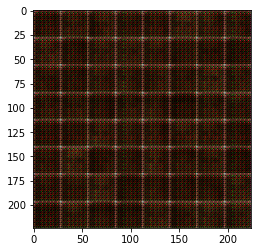

Epoch 1/1... Discriminator Loss: 1.2659... Generator Loss: 0.4089
Epoch 1/1... Discriminator Loss: 1.0088... Generator Loss: 5.0281
Epoch 1/1... Discriminator Loss: 0.3554... Generator Loss: 1.9299
Epoch 1/1... Discriminator Loss: 0.7399... Generator Loss: 0.7846
Epoch 1/1... Discriminator Loss: 0.5537... Generator Loss: 3.4005
Epoch 1/1... Discriminator Loss: 0.4964... Generator Loss: 1.4678
Epoch 1/1... Discriminator Loss: 0.5890... Generator Loss: 1.1769
Epoch 1/1... Discriminator Loss: 0.3993... Generator Loss: 2.8205
Epoch 1/1... Discriminator Loss: 0.5958... Generator Loss: 1.0497
Epoch 1/1... Discriminator Loss: 0.4211... Generator Loss: 2.3358


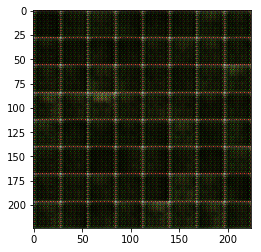

Epoch 1/1... Discriminator Loss: 0.4774... Generator Loss: 1.6882
Epoch 1/1... Discriminator Loss: 0.3886... Generator Loss: 1.7659
Epoch 1/1... Discriminator Loss: 0.3611... Generator Loss: 2.0533
Epoch 1/1... Discriminator Loss: 0.4478... Generator Loss: 1.4693
Epoch 1/1... Discriminator Loss: 0.2942... Generator Loss: 2.3190
Epoch 1/1... Discriminator Loss: 0.3441... Generator Loss: 1.8719
Epoch 1/1... Discriminator Loss: 0.3533... Generator Loss: 1.7107
Epoch 1/1... Discriminator Loss: 0.3532... Generator Loss: 2.0187
Epoch 1/1... Discriminator Loss: 0.3268... Generator Loss: 1.9006
Epoch 1/1... Discriminator Loss: 0.2930... Generator Loss: 2.0037


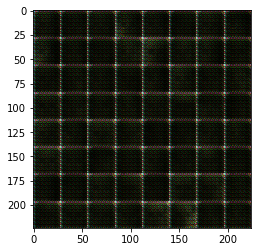

Epoch 1/1... Discriminator Loss: 0.3334... Generator Loss: 1.8255
Epoch 1/1... Discriminator Loss: 0.3195... Generator Loss: 1.9155
Epoch 1/1... Discriminator Loss: 0.3931... Generator Loss: 1.6311
Epoch 1/1... Discriminator Loss: 0.3743... Generator Loss: 1.8530
Epoch 1/1... Discriminator Loss: 0.3478... Generator Loss: 1.7623
Epoch 1/1... Discriminator Loss: 0.3552... Generator Loss: 1.8112
Epoch 1/1... Discriminator Loss: 0.3640... Generator Loss: 1.8711
Epoch 1/1... Discriminator Loss: 0.3400... Generator Loss: 1.8548
Epoch 1/1... Discriminator Loss: 0.3733... Generator Loss: 1.7185
Epoch 1/1... Discriminator Loss: 0.3488... Generator Loss: 1.8900


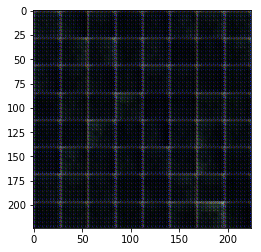

Epoch 1/1... Discriminator Loss: 0.4811... Generator Loss: 1.2853
Epoch 1/1... Discriminator Loss: 0.2780... Generator Loss: 3.0444
Epoch 1/1... Discriminator Loss: 0.3304... Generator Loss: 1.7032
Epoch 1/1... Discriminator Loss: 0.4322... Generator Loss: 1.3718
Epoch 1/1... Discriminator Loss: 0.3583... Generator Loss: 2.2523
Epoch 1/1... Discriminator Loss: 0.3655... Generator Loss: 1.8285
Epoch 1/1... Discriminator Loss: 0.3163... Generator Loss: 1.7668
Epoch 1/1... Discriminator Loss: 0.4272... Generator Loss: 1.4138
Epoch 1/1... Discriminator Loss: 0.2424... Generator Loss: 2.8244
Epoch 1/1... Discriminator Loss: 0.2390... Generator Loss: 2.0040


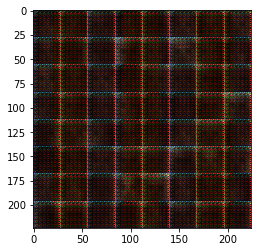

Epoch 1/1... Discriminator Loss: 0.3761... Generator Loss: 1.4827
Epoch 1/1... Discriminator Loss: 0.1981... Generator Loss: 3.6022
Epoch 1/1... Discriminator Loss: 0.2316... Generator Loss: 2.0950
Epoch 1/1... Discriminator Loss: 0.2489... Generator Loss: 1.9399
Epoch 1/1... Discriminator Loss: 0.1911... Generator Loss: 2.6842
Epoch 1/1... Discriminator Loss: 0.2712... Generator Loss: 1.9671
Epoch 1/1... Discriminator Loss: 0.2846... Generator Loss: 1.8436
Epoch 1/1... Discriminator Loss: 0.1869... Generator Loss: 2.5344
Epoch 1/1... Discriminator Loss: 0.1970... Generator Loss: 2.3055
Epoch 1/1... Discriminator Loss: 0.1991... Generator Loss: 2.4106


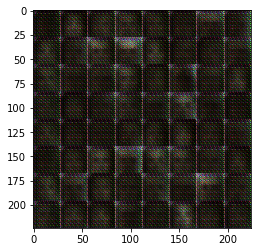

Epoch 1/1... Discriminator Loss: 0.2698... Generator Loss: 2.0702
Epoch 1/1... Discriminator Loss: 0.1513... Generator Loss: 2.8481
Epoch 1/1... Discriminator Loss: 0.1545... Generator Loss: 2.5950
Epoch 1/1... Discriminator Loss: 0.4168... Generator Loss: 1.3502
Epoch 1/1... Discriminator Loss: 1.1216... Generator Loss: 5.4541
Epoch 1/1... Discriminator Loss: 2.3284... Generator Loss: 0.1934
Epoch 1/1... Discriminator Loss: 2.1203... Generator Loss: 9.7705
Epoch 1/1... Discriminator Loss: 0.1657... Generator Loss: 2.5475
Epoch 1/1... Discriminator Loss: 1.6564... Generator Loss: 0.2940
Epoch 1/1... Discriminator Loss: 0.7598... Generator Loss: 6.1936


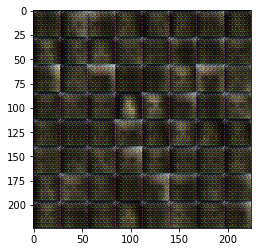

Epoch 1/1... Discriminator Loss: 0.3570... Generator Loss: 3.0039
Epoch 1/1... Discriminator Loss: 1.2071... Generator Loss: 0.4909
Epoch 1/1... Discriminator Loss: 1.0202... Generator Loss: 4.6379
Epoch 1/1... Discriminator Loss: 0.4046... Generator Loss: 1.5477
Epoch 1/1... Discriminator Loss: 0.1581... Generator Loss: 2.7162
Epoch 1/1... Discriminator Loss: 0.8038... Generator Loss: 0.8606
Epoch 1/1... Discriminator Loss: 0.6808... Generator Loss: 4.3788
Epoch 1/1... Discriminator Loss: 0.3048... Generator Loss: 2.4710
Epoch 1/1... Discriminator Loss: 0.3493... Generator Loss: 1.7284
Epoch 1/1... Discriminator Loss: 0.2024... Generator Loss: 3.0336


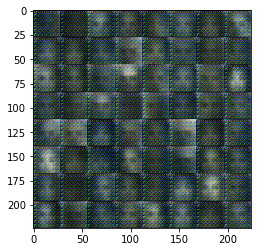

Epoch 1/1... Discriminator Loss: 0.9592... Generator Loss: 0.6903
Epoch 1/1... Discriminator Loss: 1.4040... Generator Loss: 4.8535
Epoch 1/1... Discriminator Loss: 0.9568... Generator Loss: 0.5645
Epoch 1/1... Discriminator Loss: 0.2729... Generator Loss: 5.7381
Epoch 1/1... Discriminator Loss: 0.3615... Generator Loss: 1.8634
Epoch 1/1... Discriminator Loss: 0.2697... Generator Loss: 2.3240
Epoch 1/1... Discriminator Loss: 0.2805... Generator Loss: 2.8869
Epoch 1/1... Discriminator Loss: 0.4096... Generator Loss: 1.6106
Epoch 1/1... Discriminator Loss: 0.3620... Generator Loss: 5.7967
Epoch 1/1... Discriminator Loss: 0.7204... Generator Loss: 0.8152


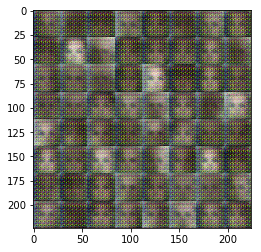

Epoch 1/1... Discriminator Loss: 1.0718... Generator Loss: 4.4331
Epoch 1/1... Discriminator Loss: 2.6793... Generator Loss: 0.1254
Epoch 1/1... Discriminator Loss: 1.6505... Generator Loss: 9.7283
Epoch 1/1... Discriminator Loss: 0.5050... Generator Loss: 1.5198
Epoch 1/1... Discriminator Loss: 0.3039... Generator Loss: 1.8823
Epoch 1/1... Discriminator Loss: 0.2095... Generator Loss: 3.4732
Epoch 1/1... Discriminator Loss: 0.6275... Generator Loss: 1.3625
Epoch 1/1... Discriminator Loss: 0.7621... Generator Loss: 1.9014
Epoch 1/1... Discriminator Loss: 0.4313... Generator Loss: 1.6642
Epoch 1/1... Discriminator Loss: 0.1329... Generator Loss: 3.9086


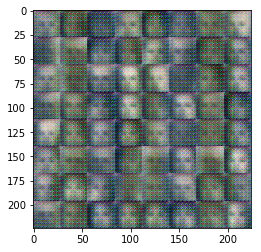

Epoch 1/1... Discriminator Loss: 2.3886... Generator Loss: 0.1403
Epoch 1/1... Discriminator Loss: 5.8157... Generator Loss: 5.3146
Epoch 1/1... Discriminator Loss: 0.6613... Generator Loss: 2.2584
Epoch 1/1... Discriminator Loss: 3.9236... Generator Loss: 0.0340
Epoch 1/1... Discriminator Loss: 0.4117... Generator Loss: 6.6493
Epoch 1/1... Discriminator Loss: 0.6773... Generator Loss: 2.6426
Epoch 1/1... Discriminator Loss: 2.1428... Generator Loss: 0.1844
Epoch 1/1... Discriminator Loss: 1.9320... Generator Loss: 2.2575
Epoch 1/1... Discriminator Loss: 1.4691... Generator Loss: 0.6562
Epoch 1/1... Discriminator Loss: 1.3538... Generator Loss: 0.6611


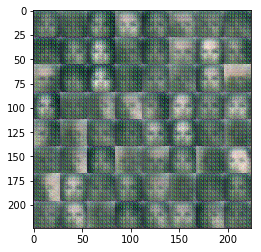

Epoch 1/1... Discriminator Loss: 1.4487... Generator Loss: 2.3405
Epoch 1/1... Discriminator Loss: 1.2995... Generator Loss: 0.5954
Epoch 1/1... Discriminator Loss: 0.3993... Generator Loss: 5.8377
Epoch 1/1... Discriminator Loss: 1.6069... Generator Loss: 0.3696
Epoch 1/1... Discriminator Loss: 0.7412... Generator Loss: 7.8138
Epoch 1/1... Discriminator Loss: 0.7929... Generator Loss: 1.1136
Epoch 1/1... Discriminator Loss: 0.2183... Generator Loss: 6.5951
Epoch 1/1... Discriminator Loss: 0.2331... Generator Loss: 2.8735
Epoch 1/1... Discriminator Loss: 0.5134... Generator Loss: 1.1488
Epoch 1/1... Discriminator Loss: 0.7653... Generator Loss: 1.2340


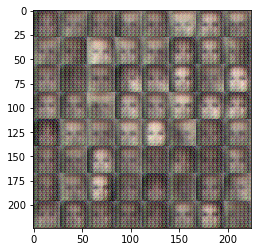

Epoch 1/1... Discriminator Loss: 0.9725... Generator Loss: 2.7323
Epoch 1/1... Discriminator Loss: 1.0939... Generator Loss: 0.5065
Epoch 1/1... Discriminator Loss: 0.5503... Generator Loss: 5.8179
Epoch 1/1... Discriminator Loss: 1.6544... Generator Loss: 0.2658
Epoch 1/1... Discriminator Loss: 1.5916... Generator Loss: 5.5574
Epoch 1/1... Discriminator Loss: 0.1669... Generator Loss: 2.7099
Epoch 1/1... Discriminator Loss: 4.2608... Generator Loss: 0.0259
Epoch 1/1... Discriminator Loss: 0.8351... Generator Loss: 2.7644
Epoch 1/1... Discriminator Loss: 0.8279... Generator Loss: 2.5940
Epoch 1/1... Discriminator Loss: 1.9756... Generator Loss: 0.2254


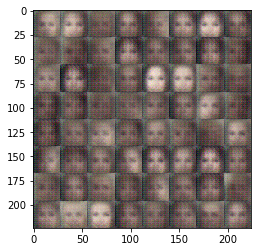

Epoch 1/1... Discriminator Loss: 1.1550... Generator Loss: 4.5570
Epoch 1/1... Discriminator Loss: 1.8635... Generator Loss: 0.3010
Epoch 1/1... Discriminator Loss: 1.3694... Generator Loss: 2.0403
Epoch 1/1... Discriminator Loss: 1.0599... Generator Loss: 0.8672
Epoch 1/1... Discriminator Loss: 1.0249... Generator Loss: 0.7646
Epoch 1/1... Discriminator Loss: 0.6642... Generator Loss: 3.8409
Epoch 1/1... Discriminator Loss: 0.7912... Generator Loss: 0.8754
Epoch 1/1... Discriminator Loss: 0.4446... Generator Loss: 2.2794
Epoch 1/1... Discriminator Loss: 0.3891... Generator Loss: 2.1890
Epoch 1/1... Discriminator Loss: 0.8757... Generator Loss: 0.7740


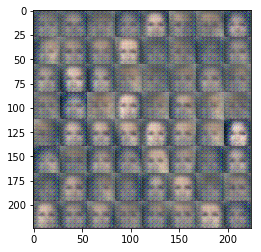

Epoch 1/1... Discriminator Loss: 0.5429... Generator Loss: 3.6000
Epoch 1/1... Discriminator Loss: 0.9254... Generator Loss: 0.7631
Epoch 1/1... Discriminator Loss: 0.7098... Generator Loss: 2.7977
Epoch 1/1... Discriminator Loss: 0.4033... Generator Loss: 1.8557
Epoch 1/1... Discriminator Loss: 0.2745... Generator Loss: 2.0925
Epoch 1/1... Discriminator Loss: 1.8588... Generator Loss: 0.2205
Epoch 1/1... Discriminator Loss: 2.4518... Generator Loss: 5.1449
Epoch 1/1... Discriminator Loss: 0.8043... Generator Loss: 1.0067
Epoch 1/1... Discriminator Loss: 2.1821... Generator Loss: 0.1565
Epoch 1/1... Discriminator Loss: 1.3745... Generator Loss: 3.3684


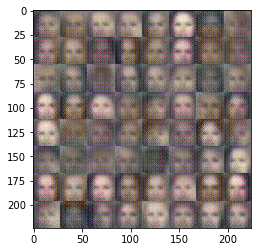

Epoch 1/1... Discriminator Loss: 0.5972... Generator Loss: 2.1370
Epoch 1/1... Discriminator Loss: 1.4385... Generator Loss: 0.3688
Epoch 1/1... Discriminator Loss: 0.5643... Generator Loss: 4.5655
Epoch 1/1... Discriminator Loss: 1.6878... Generator Loss: 0.3548
Epoch 1/1... Discriminator Loss: 1.1418... Generator Loss: 2.6008
Epoch 1/1... Discriminator Loss: 1.1073... Generator Loss: 0.6810
Epoch 1/1... Discriminator Loss: 0.5750... Generator Loss: 4.0207
Epoch 1/1... Discriminator Loss: 0.3229... Generator Loss: 2.6997
Epoch 1/1... Discriminator Loss: 0.6595... Generator Loss: 0.9927
Epoch 1/1... Discriminator Loss: 0.2394... Generator Loss: 3.7152


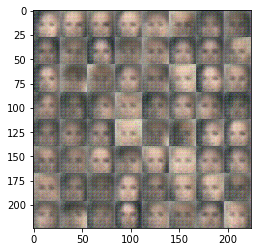

Epoch 1/1... Discriminator Loss: 1.9763... Generator Loss: 0.2036
Epoch 1/1... Discriminator Loss: 2.0031... Generator Loss: 4.7302
Epoch 1/1... Discriminator Loss: 0.6638... Generator Loss: 1.2473
Epoch 1/1... Discriminator Loss: 1.1212... Generator Loss: 0.5166
Epoch 1/1... Discriminator Loss: 0.5298... Generator Loss: 6.3170
Epoch 1/1... Discriminator Loss: 0.3431... Generator Loss: 3.0282
Epoch 1/1... Discriminator Loss: 1.1162... Generator Loss: 0.6152
Epoch 1/1... Discriminator Loss: 0.4921... Generator Loss: 3.4392
Epoch 1/1... Discriminator Loss: 0.7542... Generator Loss: 1.2013
Epoch 1/1... Discriminator Loss: 0.3214... Generator Loss: 4.2653


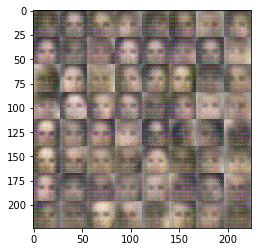

Epoch 1/1... Discriminator Loss: 1.0448... Generator Loss: 0.6354
Epoch 1/1... Discriminator Loss: 0.5463... Generator Loss: 2.9488
Epoch 1/1... Discriminator Loss: 0.3483... Generator Loss: 3.0509
Epoch 1/1... Discriminator Loss: 0.1161... Generator Loss: 4.0735
Epoch 1/1... Discriminator Loss: 2.0686... Generator Loss: 0.1750
Epoch 1/1... Discriminator Loss: 0.8474... Generator Loss: 7.1745
Epoch 1/1... Discriminator Loss: 0.6108... Generator Loss: 1.8132
Epoch 1/1... Discriminator Loss: 0.1066... Generator Loss: 6.7623
Epoch 1/1... Discriminator Loss: 0.0845... Generator Loss: 4.0035
Epoch 1/1... Discriminator Loss: 2.1834... Generator Loss: 0.1544


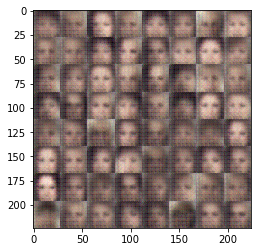

Epoch 1/1... Discriminator Loss: 0.8225... Generator Loss: 2.1609
Epoch 1/1... Discriminator Loss: 0.6715... Generator Loss: 3.0354
Epoch 1/1... Discriminator Loss: 0.7278... Generator Loss: 0.9180
Epoch 1/1... Discriminator Loss: 0.2369... Generator Loss: 3.9879
Epoch 1/1... Discriminator Loss: 0.7139... Generator Loss: 1.0243
Epoch 1/1... Discriminator Loss: 0.4654... Generator Loss: 6.1407
Epoch 1/1... Discriminator Loss: 0.7115... Generator Loss: 1.0207
Epoch 1/1... Discriminator Loss: 0.1544... Generator Loss: 5.9821
Epoch 1/1... Discriminator Loss: 0.5407... Generator Loss: 1.2106
Epoch 1/1... Discriminator Loss: 0.1508... Generator Loss: 4.4957


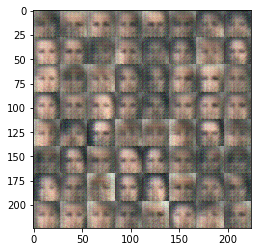

Epoch 1/1... Discriminator Loss: 0.9512... Generator Loss: 0.6300
Epoch 1/1... Discriminator Loss: 0.4432... Generator Loss: 6.3608
Epoch 1/1... Discriminator Loss: 0.3071... Generator Loss: 2.9281
Epoch 1/1... Discriminator Loss: 1.4550... Generator Loss: 0.3410
Epoch 1/1... Discriminator Loss: 0.6045... Generator Loss: 5.8800
Epoch 1/1... Discriminator Loss: 0.3611... Generator Loss: 3.0617
Epoch 1/1... Discriminator Loss: 0.0894... Generator Loss: 4.7322
Epoch 1/1... Discriminator Loss: 2.1698... Generator Loss: 0.1680
Epoch 1/1... Discriminator Loss: 0.7583... Generator Loss: 5.4761
Epoch 1/1... Discriminator Loss: 0.4422... Generator Loss: 5.5543


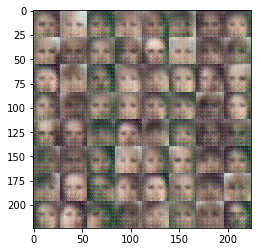

Epoch 1/1... Discriminator Loss: 0.9318... Generator Loss: 0.6450
Epoch 1/1... Discriminator Loss: 0.2605... Generator Loss: 4.9249
Epoch 1/1... Discriminator Loss: 0.8936... Generator Loss: 0.7794
Epoch 1/1... Discriminator Loss: 0.3519... Generator Loss: 6.1892
Epoch 1/1... Discriminator Loss: 0.2228... Generator Loss: 3.6448
Epoch 1/1... Discriminator Loss: 0.3890... Generator Loss: 1.6067
Epoch 1/1... Discriminator Loss: 0.1374... Generator Loss: 8.3222
Epoch 1/1... Discriminator Loss: 0.0935... Generator Loss: 6.6018
Epoch 1/1... Discriminator Loss: 0.6027... Generator Loss: 1.0814
Epoch 1/1... Discriminator Loss: 0.1533... Generator Loss: 8.7600


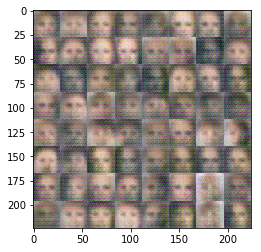

Epoch 1/1... Discriminator Loss: 0.1200... Generator Loss: 8.3810
Epoch 1/1... Discriminator Loss: 0.0759... Generator Loss: 6.0701
Epoch 1/1... Discriminator Loss: 0.5707... Generator Loss: 0.9865
Epoch 1/1... Discriminator Loss: 0.0960... Generator Loss: 5.2813
Epoch 1/1... Discriminator Loss: 0.3764... Generator Loss: 1.7129
Epoch 1/1... Discriminator Loss: 0.2079... Generator Loss: 5.4115
Epoch 1/1... Discriminator Loss: 0.2864... Generator Loss: 1.9555
Epoch 1/1... Discriminator Loss: 0.1057... Generator Loss: 6.5338
Epoch 1/1... Discriminator Loss: 0.1614... Generator Loss: 2.6676
Epoch 1/1... Discriminator Loss: 0.7809... Generator Loss: 0.7631


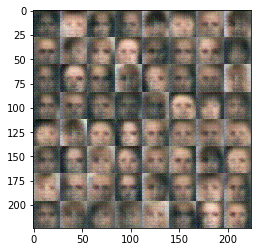

Epoch 1/1... Discriminator Loss: 0.5960... Generator Loss: 7.9813
Epoch 1/1... Discriminator Loss: 0.2254... Generator Loss: 3.7832
Epoch 1/1... Discriminator Loss: 0.0704... Generator Loss: 4.8779
Epoch 1/1... Discriminator Loss: 3.3125... Generator Loss: 0.0495
Epoch 1/1... Discriminator Loss: 1.5742... Generator Loss: 7.2718
Epoch 1/1... Discriminator Loss: 0.3438... Generator Loss: 3.7801
Epoch 1/1... Discriminator Loss: 1.0791... Generator Loss: 0.4996
Epoch 1/1... Discriminator Loss: 0.1840... Generator Loss: 5.1017
Epoch 1/1... Discriminator Loss: 0.2997... Generator Loss: 2.7811
Epoch 1/1... Discriminator Loss: 0.1655... Generator Loss: 6.7600


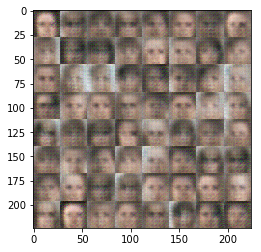

Epoch 1/1... Discriminator Loss: 0.0805... Generator Loss: 4.1501
Epoch 1/1... Discriminator Loss: 0.0915... Generator Loss: 3.3737
Epoch 1/1... Discriminator Loss: 1.5017... Generator Loss: 0.3326
Epoch 1/1... Discriminator Loss: 0.3881... Generator Loss: 4.2866
Epoch 1/1... Discriminator Loss: 0.4653... Generator Loss: 3.2151
Epoch 1/1... Discriminator Loss: 0.1574... Generator Loss: 5.0678
Epoch 1/1... Discriminator Loss: 0.6826... Generator Loss: 0.9591
Epoch 1/1... Discriminator Loss: 0.0963... Generator Loss: 4.9581
Epoch 1/1... Discriminator Loss: 0.6289... Generator Loss: 1.0063
Epoch 1/1... Discriminator Loss: 0.1959... Generator Loss: 6.6373


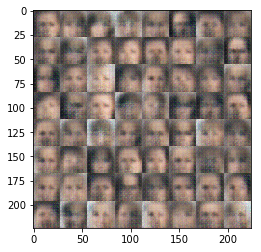

Epoch 1/1... Discriminator Loss: 0.2086... Generator Loss: 4.8622
Epoch 1/1... Discriminator Loss: 1.3293... Generator Loss: 0.3829
Epoch 1/1... Discriminator Loss: 0.4375... Generator Loss: 8.1532
Epoch 1/1... Discriminator Loss: 0.2493... Generator Loss: 5.2456
Epoch 1/1... Discriminator Loss: 0.0968... Generator Loss: 4.4637
Epoch 1/1... Discriminator Loss: 0.0755... Generator Loss: 3.5892
Epoch 1/1... Discriminator Loss: 0.7947... Generator Loss: 0.7886
Epoch 1/1... Discriminator Loss: 0.1523... Generator Loss: 6.4770
Epoch 1/1... Discriminator Loss: 0.2052... Generator Loss: 4.7641
Epoch 1/1... Discriminator Loss: 0.2019... Generator Loss: 2.7441


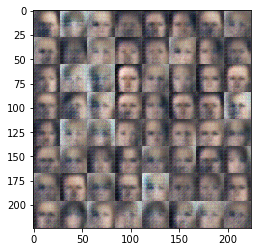

Epoch 1/1... Discriminator Loss: 0.0741... Generator Loss: 4.7512
Epoch 1/1... Discriminator Loss: 0.7357... Generator Loss: 0.8479
Epoch 1/1... Discriminator Loss: 0.1038... Generator Loss: 6.6868
Epoch 1/1... Discriminator Loss: 0.1381... Generator Loss: 3.9014
Epoch 1/1... Discriminator Loss: 0.1732... Generator Loss: 2.9534
Epoch 1/1... Discriminator Loss: 1.2261... Generator Loss: 0.4278
Epoch 1/1... Discriminator Loss: 0.8176... Generator Loss: 7.1480
Epoch 1/1... Discriminator Loss: 0.1800... Generator Loss: 4.4091
Epoch 1/1... Discriminator Loss: 1.4791... Generator Loss: 0.3439
Epoch 1/1... Discriminator Loss: 0.3649... Generator Loss: 6.5272


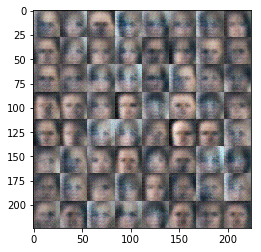

Epoch 1/1... Discriminator Loss: 0.2466... Generator Loss: 3.2595
Epoch 1/1... Discriminator Loss: 0.3188... Generator Loss: 1.7010
Epoch 1/1... Discriminator Loss: 0.0769... Generator Loss: 4.6275
Epoch 1/1... Discriminator Loss: 0.7603... Generator Loss: 0.8428
Epoch 1/1... Discriminator Loss: 0.4476... Generator Loss: 7.5947
Epoch 1/1... Discriminator Loss: 0.2271... Generator Loss: 5.0903
Epoch 1/1... Discriminator Loss: 0.2557... Generator Loss: 2.0826
Epoch 1/1... Discriminator Loss: 0.0487... Generator Loss: 4.8438
Epoch 1/1... Discriminator Loss: 0.6500... Generator Loss: 0.8928
Epoch 1/1... Discriminator Loss: 0.1522... Generator Loss: 7.4674


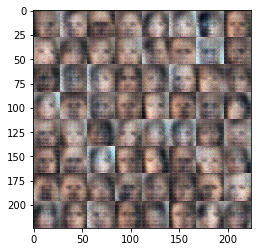

Epoch 1/1... Discriminator Loss: 0.1657... Generator Loss: 5.1715
Epoch 1/1... Discriminator Loss: 0.2580... Generator Loss: 1.8793
Epoch 1/1... Discriminator Loss: 0.0812... Generator Loss: 5.0510
Epoch 1/1... Discriminator Loss: 0.3578... Generator Loss: 1.5161
Epoch 1/1... Discriminator Loss: 0.1886... Generator Loss: 3.6182
Epoch 1/1... Discriminator Loss: 0.1705... Generator Loss: 3.7255
Epoch 1/1... Discriminator Loss: 0.1385... Generator Loss: 3.1676
Epoch 1/1... Discriminator Loss: 0.1846... Generator Loss: 2.5894
Epoch 1/1... Discriminator Loss: 0.0759... Generator Loss: 4.7204
Epoch 1/1... Discriminator Loss: 0.5309... Generator Loss: 1.0922


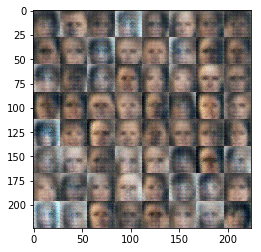

Epoch 1/1... Discriminator Loss: 0.3921... Generator Loss: 8.0822
Epoch 1/1... Discriminator Loss: 0.1644... Generator Loss: 6.5217
Epoch 1/1... Discriminator Loss: 0.2411... Generator Loss: 2.2141
Epoch 1/1... Discriminator Loss: 0.0614... Generator Loss: 3.7841
Epoch 1/1... Discriminator Loss: 0.4814... Generator Loss: 1.1926
Epoch 1/1... Discriminator Loss: 0.1932... Generator Loss: 6.7127
Epoch 1/1... Discriminator Loss: 0.2162... Generator Loss: 3.7230
Epoch 1/1... Discriminator Loss: 0.1153... Generator Loss: 3.4838
Epoch 1/1... Discriminator Loss: 0.1421... Generator Loss: 2.6087
Epoch 1/1... Discriminator Loss: 0.0774... Generator Loss: 3.6735


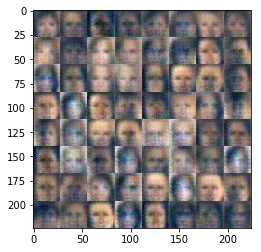

Epoch 1/1... Discriminator Loss: 0.0429... Generator Loss: 4.4767
Epoch 1/1... Discriminator Loss: 0.4884... Generator Loss: 1.1245
Epoch 1/1... Discriminator Loss: 0.2787... Generator Loss: 6.6405
Epoch 1/1... Discriminator Loss: 0.6340... Generator Loss: 1.1230
Epoch 1/1... Discriminator Loss: 0.2294... Generator Loss: 9.5202
Epoch 1/1... Discriminator Loss: 0.0938... Generator Loss: 7.9853
Epoch 1/1... Discriminator Loss: 0.0996... Generator Loss: 3.2344
Epoch 1/1... Discriminator Loss: 0.1654... Generator Loss: 2.2606
Epoch 1/1... Discriminator Loss: 0.0329... Generator Loss: 5.0964
Epoch 1/1... Discriminator Loss: 0.4319... Generator Loss: 1.2112


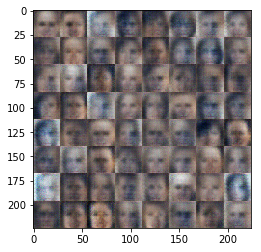

Epoch 1/1... Discriminator Loss: 0.1754... Generator Loss: 7.2113
Epoch 1/1... Discriminator Loss: 0.4121... Generator Loss: 1.7469
Epoch 1/1... Discriminator Loss: 0.0946... Generator Loss: 8.2231
Epoch 1/1... Discriminator Loss: 0.0536... Generator Loss: 5.8129
Epoch 1/1... Discriminator Loss: 0.4868... Generator Loss: 1.1530
Epoch 1/1... Discriminator Loss: 0.1136... Generator Loss: 7.7741
Epoch 1/1... Discriminator Loss: 0.0941... Generator Loss: 5.2304
Epoch 1/1... Discriminator Loss: 0.0703... Generator Loss: 5.7557
Epoch 1/1... Discriminator Loss: 0.4958... Generator Loss: 1.2134
Epoch 1/1... Discriminator Loss: 0.3177... Generator Loss: 9.5036


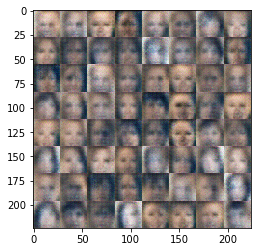

Epoch 1/1... Discriminator Loss: 0.0765... Generator Loss: 5.1923
Epoch 1/1... Discriminator Loss: 0.0241... Generator Loss: 5.2921
Epoch 1/1... Discriminator Loss: 0.0240... Generator Loss: 6.7841
Epoch 1/1... Discriminator Loss: 0.2111... Generator Loss: 2.1480
Epoch 1/1... Discriminator Loss: 0.0196... Generator Loss: 6.8416
Epoch 1/1... Discriminator Loss: 0.2106... Generator Loss: 2.0993
Epoch 1/1... Discriminator Loss: 0.0337... Generator Loss: 6.3884
Epoch 1/1... Discriminator Loss: 0.0768... Generator Loss: 3.8246
Epoch 1/1... Discriminator Loss: 1.1536... Generator Loss: 0.5320
Epoch 1/1... Discriminator Loss: 0.6539... Generator Loss: 10.1375


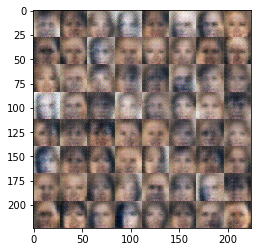

Epoch 1/1... Discriminator Loss: 0.1297... Generator Loss: 7.7825
Epoch 1/1... Discriminator Loss: 0.0726... Generator Loss: 3.5015
Epoch 1/1... Discriminator Loss: 0.0664... Generator Loss: 3.5807
Epoch 1/1... Discriminator Loss: 0.8519... Generator Loss: 0.7107
Epoch 1/1... Discriminator Loss: 0.2982... Generator Loss: 6.8224
Epoch 1/1... Discriminator Loss: 0.3488... Generator Loss: 4.1735
Epoch 1/1... Discriminator Loss: 0.0690... Generator Loss: 6.2649
Epoch 1/1... Discriminator Loss: 1.1111... Generator Loss: 0.5005
Epoch 1/1... Discriminator Loss: 0.5424... Generator Loss: 6.2251
Epoch 1/1... Discriminator Loss: 0.1458... Generator Loss: 3.9017


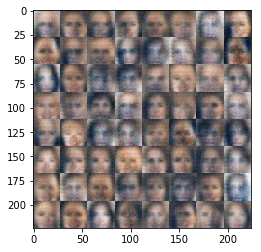

Epoch 1/1... Discriminator Loss: 1.3415... Generator Loss: 0.4152
Epoch 1/1... Discriminator Loss: 0.9529... Generator Loss: 9.5270
Epoch 1/1... Discriminator Loss: 0.1408... Generator Loss: 6.5485
Epoch 1/1... Discriminator Loss: 0.2355... Generator Loss: 1.8889
Epoch 1/1... Discriminator Loss: 0.0285... Generator Loss: 7.9426
Epoch 1/1... Discriminator Loss: 0.0331... Generator Loss: 6.2856
Epoch 1/1... Discriminator Loss: 0.7389... Generator Loss: 0.7712
Epoch 1/1... Discriminator Loss: 0.1321... Generator Loss: 7.2089
Epoch 1/1... Discriminator Loss: 0.3383... Generator Loss: 2.2102
Epoch 1/1... Discriminator Loss: 0.1816... Generator Loss: 6.2549


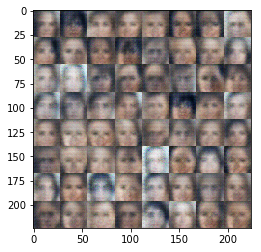

Epoch 1/1... Discriminator Loss: 0.4848... Generator Loss: 1.2042
Epoch 1/1... Discriminator Loss: 0.1431... Generator Loss: 7.5097
Epoch 1/1... Discriminator Loss: 0.1159... Generator Loss: 4.5254
Epoch 1/1... Discriminator Loss: 0.1011... Generator Loss: 3.1455
Epoch 1/1... Discriminator Loss: 0.0421... Generator Loss: 6.9097
Epoch 1/1... Discriminator Loss: 0.2439... Generator Loss: 2.0038
Epoch 1/1... Discriminator Loss: 0.0482... Generator Loss: 7.9917
Epoch 1/1... Discriminator Loss: 0.0501... Generator Loss: 7.2526
Epoch 1/1... Discriminator Loss: 0.0751... Generator Loss: 3.8777
Epoch 1/1... Discriminator Loss: 0.5203... Generator Loss: 1.1245


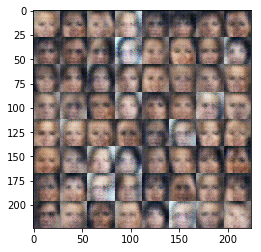

Epoch 1/1... Discriminator Loss: 0.1897... Generator Loss: 8.3381
Epoch 1/1... Discriminator Loss: 0.1153... Generator Loss: 6.8823
Epoch 1/1... Discriminator Loss: 0.1702... Generator Loss: 2.3115
Epoch 1/1... Discriminator Loss: 0.0469... Generator Loss: 5.7955
Epoch 1/1... Discriminator Loss: 0.6852... Generator Loss: 0.9051
Epoch 1/1... Discriminator Loss: 0.1515... Generator Loss: 5.6677
Epoch 1/1... Discriminator Loss: 0.1807... Generator Loss: 2.8489
Epoch 1/1... Discriminator Loss: 0.0989... Generator Loss: 7.3105
Epoch 1/1... Discriminator Loss: 0.1455... Generator Loss: 2.5467
Epoch 1/1... Discriminator Loss: 0.0379... Generator Loss: 5.6147


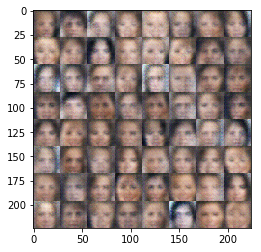

Epoch 1/1... Discriminator Loss: 0.2329... Generator Loss: 1.8481
Epoch 1/1... Discriminator Loss: 0.1552... Generator Loss: 2.5786
Epoch 1/1... Discriminator Loss: 0.1354... Generator Loss: 9.5544
Epoch 1/1... Discriminator Loss: 0.0691... Generator Loss: 7.9792
Epoch 1/1... Discriminator Loss: 0.2502... Generator Loss: 1.9089
Epoch 1/1... Discriminator Loss: 0.0417... Generator Loss: 8.3415
Epoch 1/1... Discriminator Loss: 0.0549... Generator Loss: 5.1887
Epoch 1/1... Discriminator Loss: 0.3271... Generator Loss: 1.5081
Epoch 1/1... Discriminator Loss: 0.1322... Generator Loss: 10.4364
Epoch 1/1... Discriminator Loss: 0.1258... Generator Loss: 9.6187


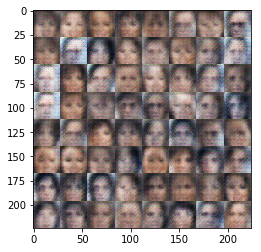

Epoch 1/1... Discriminator Loss: 0.0549... Generator Loss: 5.1832
Epoch 1/1... Discriminator Loss: 0.0260... Generator Loss: 5.2077
Epoch 1/1... Discriminator Loss: 0.0124... Generator Loss: 6.8282
Epoch 1/1... Discriminator Loss: 0.4142... Generator Loss: 1.3663
Epoch 1/1... Discriminator Loss: 0.0579... Generator Loss: 8.3063
Epoch 1/1... Discriminator Loss: 0.1032... Generator Loss: 5.8603
Epoch 1/1... Discriminator Loss: 0.1501... Generator Loss: 2.6674
Epoch 1/1... Discriminator Loss: 0.0852... Generator Loss: 3.8273
Epoch 1/1... Discriminator Loss: 0.0527... Generator Loss: 7.1327
Epoch 1/1... Discriminator Loss: 0.1246... Generator Loss: 2.9321


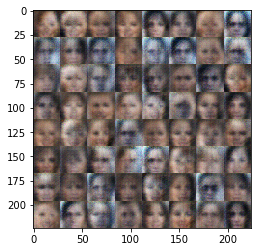

Epoch 1/1... Discriminator Loss: 0.0306... Generator Loss: 6.9983
Epoch 1/1... Discriminator Loss: 0.1137... Generator Loss: 2.8003
Epoch 1/1... Discriminator Loss: 0.0698... Generator Loss: 3.9047
Epoch 1/1... Discriminator Loss: 0.0658... Generator Loss: 4.2045
Epoch 1/1... Discriminator Loss: 0.0412... Generator Loss: 5.1110
Epoch 1/1... Discriminator Loss: 0.8140... Generator Loss: 0.9077
Epoch 1/1... Discriminator Loss: 0.8357... Generator Loss: 9.8644
Epoch 1/1... Discriminator Loss: 0.0528... Generator Loss: 6.4493
Epoch 1/1... Discriminator Loss: 1.2707... Generator Loss: 0.3782
Epoch 1/1... Discriminator Loss: 0.4209... Generator Loss: 9.0531


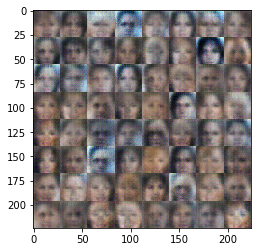

Epoch 1/1... Discriminator Loss: 0.1988... Generator Loss: 7.2947
Epoch 1/1... Discriminator Loss: 0.0905... Generator Loss: 3.5246
Epoch 1/1... Discriminator Loss: 1.2483... Generator Loss: 0.4470
Epoch 1/1... Discriminator Loss: 1.4917... Generator Loss: 9.9642
Epoch 1/1... Discriminator Loss: 0.0536... Generator Loss: 7.9812
Epoch 1/1... Discriminator Loss: 0.0357... Generator Loss: 5.1838
Epoch 1/1... Discriminator Loss: 0.4991... Generator Loss: 1.2711
Epoch 1/1... Discriminator Loss: 0.3458... Generator Loss: 2.0786
Epoch 1/1... Discriminator Loss: 0.0717... Generator Loss: 5.6308
Epoch 1/1... Discriminator Loss: 0.0341... Generator Loss: 4.7602


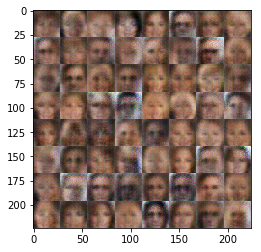

Epoch 1/1... Discriminator Loss: 1.2637... Generator Loss: 0.4013
Epoch 1/1... Discriminator Loss: 1.4074... Generator Loss: 9.7274
Epoch 1/1... Discriminator Loss: 0.0290... Generator Loss: 7.6747
Epoch 1/1... Discriminator Loss: 0.3312... Generator Loss: 1.4449
Epoch 1/1... Discriminator Loss: 0.0513... Generator Loss: 4.4333
Epoch 1/1... Discriminator Loss: 0.2332... Generator Loss: 2.6626
Epoch 1/1... Discriminator Loss: 0.1293... Generator Loss: 10.0057
Epoch 1/1... Discriminator Loss: 0.0619... Generator Loss: 9.5674
Epoch 1/1... Discriminator Loss: 0.0332... Generator Loss: 7.8644
Epoch 1/1... Discriminator Loss: 0.0574... Generator Loss: 4.5449


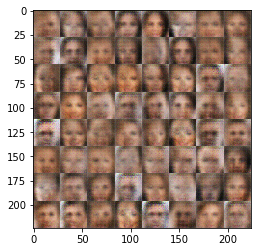

Epoch 1/1... Discriminator Loss: 0.8318... Generator Loss: 0.6486
Epoch 1/1... Discriminator Loss: 0.2275... Generator Loss: 8.0688
Epoch 1/1... Discriminator Loss: 0.2558... Generator Loss: 6.4254
Epoch 1/1... Discriminator Loss: 0.1003... Generator Loss: 3.4558
Epoch 1/1... Discriminator Loss: 0.0155... Generator Loss: 7.6065
Epoch 1/1... Discriminator Loss: 0.2295... Generator Loss: 1.8722
Epoch 1/1... Discriminator Loss: 0.0105... Generator Loss: 6.9719
Epoch 1/1... Discriminator Loss: 0.0308... Generator Loss: 4.8841
Epoch 1/1... Discriminator Loss: 0.5041... Generator Loss: 1.1413
Epoch 1/1... Discriminator Loss: 0.1915... Generator Loss: 8.8665


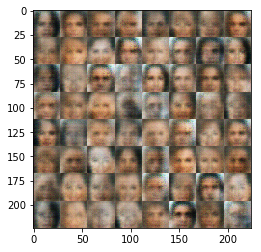

Epoch 1/1... Discriminator Loss: 0.1911... Generator Loss: 6.0606
Epoch 1/1... Discriminator Loss: 0.0764... Generator Loss: 3.6136
Epoch 1/1... Discriminator Loss: 0.0240... Generator Loss: 7.7869
Epoch 1/1... Discriminator Loss: 0.0574... Generator Loss: 3.6285
Epoch 1/1... Discriminator Loss: 0.0262... Generator Loss: 5.1428
Epoch 1/1... Discriminator Loss: 0.5130... Generator Loss: 1.0618
Epoch 1/1... Discriminator Loss: 0.1707... Generator Loss: 3.8205
Epoch 1/1... Discriminator Loss: 0.2266... Generator Loss: 6.2493
Epoch 1/1... Discriminator Loss: 0.0535... Generator Loss: 7.5409
Epoch 1/1... Discriminator Loss: 0.2843... Generator Loss: 1.7869


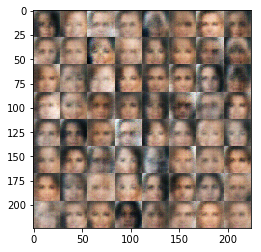

Epoch 1/1... Discriminator Loss: 0.0210... Generator Loss: 6.9334
Epoch 1/1... Discriminator Loss: 0.0756... Generator Loss: 3.6988
Epoch 1/1... Discriminator Loss: 0.2065... Generator Loss: 2.3742
Epoch 1/1... Discriminator Loss: 0.0739... Generator Loss: 10.1059
Epoch 1/1... Discriminator Loss: 0.0782... Generator Loss: 10.0457
Epoch 1/1... Discriminator Loss: 0.0425... Generator Loss: 7.9784
Epoch 1/1... Discriminator Loss: 0.0480... Generator Loss: 4.9010
Epoch 1/1... Discriminator Loss: 0.2003... Generator Loss: 2.1640
Epoch 1/1... Discriminator Loss: 0.0336... Generator Loss: 7.4791
Epoch 1/1... Discriminator Loss: 0.0514... Generator Loss: 4.8863


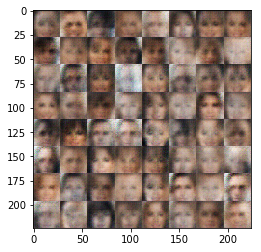

Epoch 1/1... Discriminator Loss: 0.0563... Generator Loss: 4.2785
Epoch 1/1... Discriminator Loss: 0.0185... Generator Loss: 7.5843
Epoch 1/1... Discriminator Loss: 0.0587... Generator Loss: 3.7458
Epoch 1/1... Discriminator Loss: 0.0581... Generator Loss: 3.7857
Epoch 1/1... Discriminator Loss: 0.4312... Generator Loss: 1.3761
Epoch 1/1... Discriminator Loss: 0.2608... Generator Loss: 10.7662
Epoch 1/1... Discriminator Loss: 0.1216... Generator Loss: 10.3937
Epoch 1/1... Discriminator Loss: 0.0352... Generator Loss: 6.8853
Epoch 1/1... Discriminator Loss: 0.0521... Generator Loss: 3.7312
Epoch 1/1... Discriminator Loss: 0.3259... Generator Loss: 1.7578


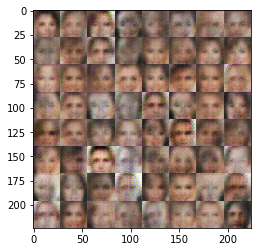

Epoch 1/1... Discriminator Loss: 0.0845... Generator Loss: 5.9433
Epoch 1/1... Discriminator Loss: 0.1233... Generator Loss: 4.0470
Epoch 1/1... Discriminator Loss: 0.1565... Generator Loss: 2.5469
Epoch 1/1... Discriminator Loss: 0.0820... Generator Loss: 7.2929
Epoch 1/1... Discriminator Loss: 0.0479... Generator Loss: 4.8764
Epoch 1/1... Discriminator Loss: 0.7745... Generator Loss: 0.7480
Epoch 1/1... Discriminator Loss: 0.2598... Generator Loss: 10.8363
Epoch 1/1... Discriminator Loss: 0.1640... Generator Loss: 10.4521
Epoch 1/1... Discriminator Loss: 0.0468... Generator Loss: 7.7578
Epoch 1/1... Discriminator Loss: 0.0184... Generator Loss: 6.0237


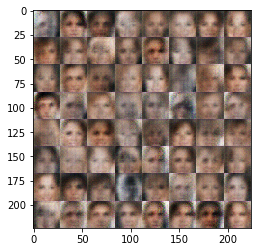

Epoch 1/1... Discriminator Loss: 0.1705... Generator Loss: 2.2286
Epoch 1/1... Discriminator Loss: 0.0742... Generator Loss: 3.0621
Epoch 1/1... Discriminator Loss: 0.0559... Generator Loss: 3.9186
Epoch 1/1... Discriminator Loss: 0.1046... Generator Loss: 3.0136
Epoch 1/1... Discriminator Loss: 0.0359... Generator Loss: 8.5873
Epoch 1/1... Discriminator Loss: 0.0331... Generator Loss: 7.7473
Epoch 1/1... Discriminator Loss: 0.0583... Generator Loss: 3.8787
Epoch 1/1... Discriminator Loss: 0.0378... Generator Loss: 4.8531
Epoch 1/1... Discriminator Loss: 0.0290... Generator Loss: 7.0423
Epoch 1/1... Discriminator Loss: 1.0454... Generator Loss: 0.5373


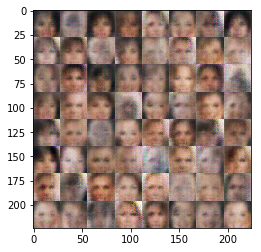

Epoch 1/1... Discriminator Loss: 1.4786... Generator Loss: 12.7332
Epoch 1/1... Discriminator Loss: 0.0436... Generator Loss: 11.0312
Epoch 1/1... Discriminator Loss: 0.0141... Generator Loss: 8.4426
Epoch 1/1... Discriminator Loss: 0.0179... Generator Loss: 5.2485
Epoch 1/1... Discriminator Loss: 0.0995... Generator Loss: 2.6924
Epoch 1/1... Discriminator Loss: 1.2852... Generator Loss: 0.3936
Epoch 1/1... Discriminator Loss: 0.6664... Generator Loss: 7.0991
Epoch 1/1... Discriminator Loss: 0.2424... Generator Loss: 5.1042
Epoch 1/1... Discriminator Loss: 0.0434... Generator Loss: 7.1102
Epoch 1/1... Discriminator Loss: 0.3865... Generator Loss: 1.5086


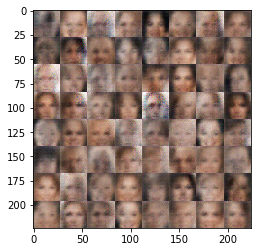

Epoch 1/1... Discriminator Loss: 0.0683... Generator Loss: 8.5556
Epoch 1/1... Discriminator Loss: 0.0766... Generator Loss: 9.0655
Epoch 1/1... Discriminator Loss: 0.0527... Generator Loss: 7.8062
Epoch 1/1... Discriminator Loss: 0.0201... Generator Loss: 6.5810
Epoch 1/1... Discriminator Loss: 0.0318... Generator Loss: 5.2535
Epoch 1/1... Discriminator Loss: 0.0758... Generator Loss: 3.5133
Epoch 1/1... Discriminator Loss: 0.3761... Generator Loss: 1.3277
Epoch 1/1... Discriminator Loss: 0.0440... Generator Loss: 7.1263
Epoch 1/1... Discriminator Loss: 0.0969... Generator Loss: 4.7341
Epoch 1/1... Discriminator Loss: 0.1021... Generator Loss: 3.5234


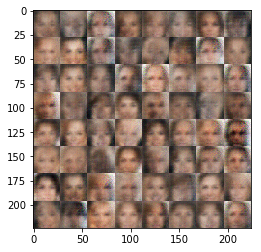

Epoch 1/1... Discriminator Loss: 0.0701... Generator Loss: 5.4718
Epoch 1/1... Discriminator Loss: 0.1617... Generator Loss: 2.7518
Epoch 1/1... Discriminator Loss: 0.0415... Generator Loss: 10.3740
Epoch 1/1... Discriminator Loss: 0.0308... Generator Loss: 9.4747
Epoch 1/1... Discriminator Loss: 0.0308... Generator Loss: 6.3298
Epoch 1/1... Discriminator Loss: 0.7048... Generator Loss: 0.9260
Epoch 1/1... Discriminator Loss: 0.6549... Generator Loss: 8.9813
Epoch 1/1... Discriminator Loss: 0.1040... Generator Loss: 4.2273
Epoch 1/1... Discriminator Loss: 0.0267... Generator Loss: 7.5361
Epoch 1/1... Discriminator Loss: 0.0485... Generator Loss: 3.8561


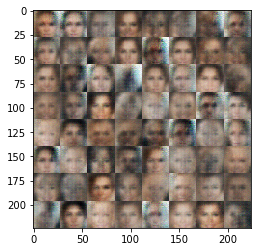

Epoch 1/1... Discriminator Loss: 0.0198... Generator Loss: 5.5270
Epoch 1/1... Discriminator Loss: 0.2609... Generator Loss: 1.8151
Epoch 1/1... Discriminator Loss: 0.0251... Generator Loss: 7.0688
Epoch 1/1... Discriminator Loss: 0.1159... Generator Loss: 3.0835
Epoch 1/1... Discriminator Loss: 0.0515... Generator Loss: 5.9922
Epoch 1/1... Discriminator Loss: 0.1297... Generator Loss: 2.7257
Epoch 1/1... Discriminator Loss: 0.0731... Generator Loss: 6.8509
Epoch 1/1... Discriminator Loss: 0.2129... Generator Loss: 2.2035
Epoch 1/1... Discriminator Loss: 0.0465... Generator Loss: 5.5297
Epoch 1/1... Discriminator Loss: 0.0520... Generator Loss: 5.1025


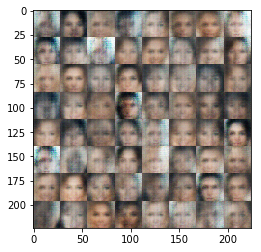

Epoch 1/1... Discriminator Loss: 0.0616... Generator Loss: 4.0111
Epoch 1/1... Discriminator Loss: 0.0306... Generator Loss: 5.9282
Epoch 1/1... Discriminator Loss: 1.8619... Generator Loss: 0.2101
Epoch 1/1... Discriminator Loss: 2.0908... Generator Loss: 11.2478
Epoch 1/1... Discriminator Loss: 0.1253... Generator Loss: 6.4565
Epoch 1/1... Discriminator Loss: 0.2098... Generator Loss: 1.9981
Epoch 1/1... Discriminator Loss: 0.0225... Generator Loss: 9.0780
Epoch 1/1... Discriminator Loss: 0.0179... Generator Loss: 8.5627
Epoch 1/1... Discriminator Loss: 0.0259... Generator Loss: 5.1691
Epoch 1/1... Discriminator Loss: 0.1564... Generator Loss: 2.4036


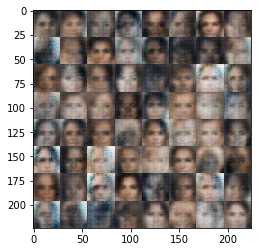

Epoch 1/1... Discriminator Loss: 0.2151... Generator Loss: 2.0563
Epoch 1/1... Discriminator Loss: 0.3872... Generator Loss: 1.5140
Epoch 1/1... Discriminator Loss: 0.2496... Generator Loss: 7.1870
Epoch 1/1... Discriminator Loss: 0.3716... Generator Loss: 1.5970
Epoch 1/1... Discriminator Loss: 0.0524... Generator Loss: 8.5830
Epoch 1/1... Discriminator Loss: 0.0409... Generator Loss: 7.0094
Epoch 1/1... Discriminator Loss: 0.1778... Generator Loss: 2.1636
Epoch 1/1... Discriminator Loss: 0.0395... Generator Loss: 7.5317
Epoch 1/1... Discriminator Loss: 0.0860... Generator Loss: 3.3769
Epoch 1/1... Discriminator Loss: 0.0320... Generator Loss: 7.6406


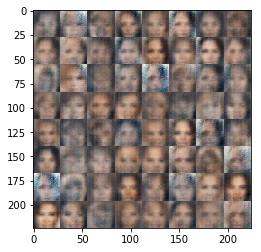

Epoch 1/1... Discriminator Loss: 0.0358... Generator Loss: 5.6451
Epoch 1/1... Discriminator Loss: 0.0675... Generator Loss: 3.3617
Epoch 1/1... Discriminator Loss: 0.0159... Generator Loss: 7.8396
Epoch 1/1... Discriminator Loss: 0.0358... Generator Loss: 4.9224
Epoch 1/1... Discriminator Loss: 0.0276... Generator Loss: 5.1622
Epoch 1/1... Discriminator Loss: 0.1208... Generator Loss: 2.6202
Epoch 1/1... Discriminator Loss: 0.0327... Generator Loss: 6.4752
Epoch 1/1... Discriminator Loss: 2.3306... Generator Loss: 0.1224
Epoch 1/1... Discriminator Loss: 3.4074... Generator Loss: 13.1668
Epoch 1/1... Discriminator Loss: 0.2539... Generator Loss: 10.1825


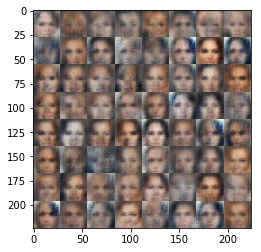

Epoch 1/1... Discriminator Loss: 0.0296... Generator Loss: 6.9414
Epoch 1/1... Discriminator Loss: 0.0424... Generator Loss: 4.5089
Epoch 1/1... Discriminator Loss: 0.4629... Generator Loss: 1.4810
Epoch 1/1... Discriminator Loss: 0.2150... Generator Loss: 2.2048
Epoch 1/1... Discriminator Loss: 0.4679... Generator Loss: 1.3219
Epoch 1/1... Discriminator Loss: 0.5754... Generator Loss: 10.0449
Epoch 1/1... Discriminator Loss: 0.0684... Generator Loss: 5.4029
Epoch 1/1... Discriminator Loss: 0.0482... Generator Loss: 4.2471
Epoch 1/1... Discriminator Loss: 0.0217... Generator Loss: 5.9707
Epoch 1/1... Discriminator Loss: 2.0331... Generator Loss: 0.2170


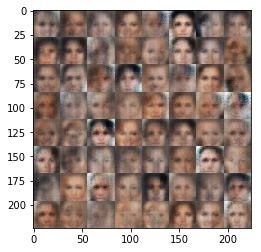

Epoch 1/1... Discriminator Loss: 0.8686... Generator Loss: 7.7997
Epoch 1/1... Discriminator Loss: 0.2944... Generator Loss: 4.7858
Epoch 1/1... Discriminator Loss: 0.0671... Generator Loss: 7.4346
Epoch 1/1... Discriminator Loss: 0.2362... Generator Loss: 1.9753
Epoch 1/1... Discriminator Loss: 0.0826... Generator Loss: 3.6902
Epoch 1/1... Discriminator Loss: 0.0763... Generator Loss: 3.4172
Epoch 1/1... Discriminator Loss: 0.0346... Generator Loss: 7.0349
Epoch 1/1... Discriminator Loss: 0.2836... Generator Loss: 1.7411
Epoch 1/1... Discriminator Loss: 0.0534... Generator Loss: 9.6506
Epoch 1/1... Discriminator Loss: 0.0341... Generator Loss: 9.4407


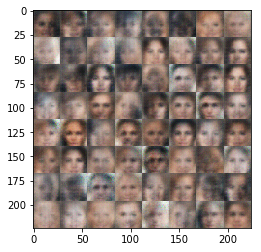

Epoch 1/1... Discriminator Loss: 0.0312... Generator Loss: 7.0983
Epoch 1/1... Discriminator Loss: 0.1071... Generator Loss: 3.0362
Epoch 1/1... Discriminator Loss: 0.0375... Generator Loss: 7.4432
Epoch 1/1... Discriminator Loss: 0.0495... Generator Loss: 4.0404
Epoch 1/1... Discriminator Loss: 0.4752... Generator Loss: 1.1666
Epoch 1/1... Discriminator Loss: 0.5617... Generator Loss: 5.1565
Epoch 1/1... Discriminator Loss: 1.2978... Generator Loss: 0.4060
Epoch 1/1... Discriminator Loss: 2.5140... Generator Loss: 6.8761
Epoch 1/1... Discriminator Loss: 1.1815... Generator Loss: 0.4263
Epoch 1/1... Discriminator Loss: 1.4325... Generator Loss: 10.0538


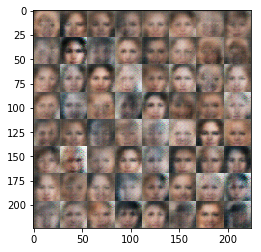

Epoch 1/1... Discriminator Loss: 0.0084... Generator Loss: 6.9900
Epoch 1/1... Discriminator Loss: 0.2149... Generator Loss: 2.2083
Epoch 1/1... Discriminator Loss: 2.4379... Generator Loss: 0.3556
Epoch 1/1... Discriminator Loss: 0.9645... Generator Loss: 7.9093
Epoch 1/1... Discriminator Loss: 0.0729... Generator Loss: 5.4106
Epoch 1/1... Discriminator Loss: 0.3858... Generator Loss: 1.5939
Epoch 1/1... Discriminator Loss: 0.0849... Generator Loss: 4.5750
Epoch 1/1... Discriminator Loss: 0.6417... Generator Loss: 1.0246
Epoch 1/1... Discriminator Loss: 0.2420... Generator Loss: 9.8038
Epoch 1/1... Discriminator Loss: 0.1057... Generator Loss: 8.9356


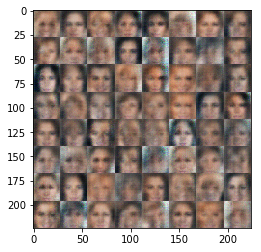

Epoch 1/1... Discriminator Loss: 0.0631... Generator Loss: 5.1310
Epoch 1/1... Discriminator Loss: 0.3823... Generator Loss: 1.5022
Epoch 1/1... Discriminator Loss: 0.0767... Generator Loss: 5.3223
Epoch 1/1... Discriminator Loss: 0.4373... Generator Loss: 1.3496
Epoch 1/1... Discriminator Loss: 0.1945... Generator Loss: 8.6228
Epoch 1/1... Discriminator Loss: 0.0999... Generator Loss: 6.9703
Epoch 1/1... Discriminator Loss: 0.1423... Generator Loss: 2.6821
Epoch 1/1... Discriminator Loss: 0.1106... Generator Loss: 3.0923
Epoch 1/1... Discriminator Loss: 0.0992... Generator Loss: 3.1752
Epoch 1/1... Discriminator Loss: 0.2604... Generator Loss: 1.8301


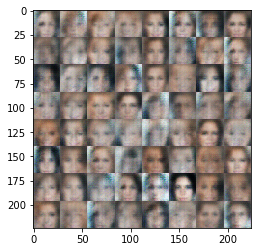

Epoch 1/1... Discriminator Loss: 0.1089... Generator Loss: 9.0254
Epoch 1/1... Discriminator Loss: 0.1131... Generator Loss: 8.4956
Epoch 1/1... Discriminator Loss: 0.0892... Generator Loss: 3.4114
Epoch 1/1... Discriminator Loss: 0.0680... Generator Loss: 4.9836
Epoch 1/1... Discriminator Loss: 0.2137... Generator Loss: 2.0055
Epoch 1/1... Discriminator Loss: 0.0254... Generator Loss: 8.7744
Epoch 1/1... Discriminator Loss: 0.0497... Generator Loss: 4.8380
Epoch 1/1... Discriminator Loss: 0.0255... Generator Loss: 5.7319
Epoch 1/1... Discriminator Loss: 0.5005... Generator Loss: 1.1415
Epoch 1/1... Discriminator Loss: 0.0836... Generator Loss: 7.4499


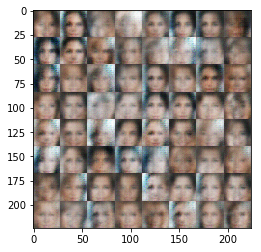

Epoch 1/1... Discriminator Loss: 0.2259... Generator Loss: 2.5616
Epoch 1/1... Discriminator Loss: 0.0664... Generator Loss: 6.8043
Epoch 1/1... Discriminator Loss: 0.1785... Generator Loss: 2.5020
Epoch 1/1... Discriminator Loss: 0.0788... Generator Loss: 3.1804
Epoch 1/1... Discriminator Loss: 0.2856... Generator Loss: 1.6258
Epoch 1/1... Discriminator Loss: 0.0640... Generator Loss: 8.6484
Epoch 1/1... Discriminator Loss: 0.1217... Generator Loss: 5.6692
Epoch 1/1... Discriminator Loss: 0.0668... Generator Loss: 4.7171
Epoch 1/1... Discriminator Loss: 0.0350... Generator Loss: 6.5280
Epoch 1/1... Discriminator Loss: 0.1239... Generator Loss: 2.9491


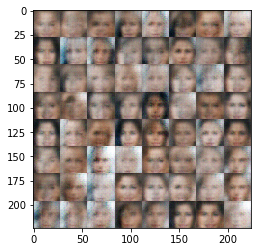

Epoch 1/1... Discriminator Loss: 0.0472... Generator Loss: 5.3182
Epoch 1/1... Discriminator Loss: 0.1411... Generator Loss: 2.4877
Epoch 1/1... Discriminator Loss: 0.0549... Generator Loss: 6.2090
Epoch 1/1... Discriminator Loss: 0.1629... Generator Loss: 2.5970
Epoch 1/1... Discriminator Loss: 0.0592... Generator Loss: 4.5333
Epoch 1/1... Discriminator Loss: 0.0630... Generator Loss: 5.2932
Epoch 1/1... Discriminator Loss: 1.3067... Generator Loss: 0.3951
Epoch 1/1... Discriminator Loss: 2.4086... Generator Loss: 9.7507
Epoch 1/1... Discriminator Loss: 0.0549... Generator Loss: 5.4760
Epoch 1/1... Discriminator Loss: 1.3755... Generator Loss: 0.4315


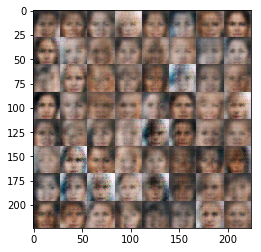

Epoch 1/1... Discriminator Loss: 0.4357... Generator Loss: 9.2511
Epoch 1/1... Discriminator Loss: 0.1869... Generator Loss: 7.9495
Epoch 1/1... Discriminator Loss: 0.0958... Generator Loss: 3.3739
Epoch 1/1... Discriminator Loss: 0.0205... Generator Loss: 7.5841
Epoch 1/1... Discriminator Loss: 0.0196... Generator Loss: 5.7186
Epoch 1/1... Discriminator Loss: 0.1574... Generator Loss: 2.2224
Epoch 1/1... Discriminator Loss: 0.0742... Generator Loss: 3.2318
Epoch 1/1... Discriminator Loss: 0.0260... Generator Loss: 5.8895
Epoch 1/1... Discriminator Loss: 0.5655... Generator Loss: 1.0376
Epoch 1/1... Discriminator Loss: 0.1751... Generator Loss: 8.6876


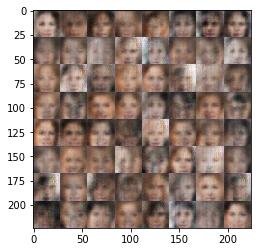

Epoch 1/1... Discriminator Loss: 0.1662... Generator Loss: 8.9854
Epoch 1/1... Discriminator Loss: 0.0762... Generator Loss: 7.8488
Epoch 1/1... Discriminator Loss: 0.0422... Generator Loss: 6.1628
Epoch 1/1... Discriminator Loss: 0.0873... Generator Loss: 3.4095
Epoch 1/1... Discriminator Loss: 0.0342... Generator Loss: 5.5828
Epoch 1/1... Discriminator Loss: 0.0521... Generator Loss: 3.9260
Epoch 1/1... Discriminator Loss: 0.2116... Generator Loss: 2.1335
Epoch 1/1... Discriminator Loss: 0.0262... Generator Loss: 7.5055
Epoch 1/1... Discriminator Loss: 0.0413... Generator Loss: 5.2786
Epoch 1/1... Discriminator Loss: 0.0548... Generator Loss: 5.4187


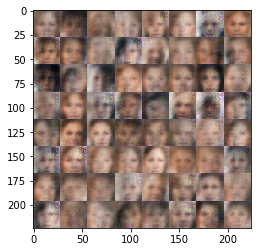

Epoch 1/1... Discriminator Loss: 0.0397... Generator Loss: 4.7639
Epoch 1/1... Discriminator Loss: 0.8695... Generator Loss: 0.7311
Epoch 1/1... Discriminator Loss: 0.4849... Generator Loss: 8.6371
Epoch 1/1... Discriminator Loss: 0.1331... Generator Loss: 4.8869
Epoch 1/1... Discriminator Loss: 0.0819... Generator Loss: 3.6402
Epoch 1/1... Discriminator Loss: 0.0138... Generator Loss: 6.6130
Epoch 1/1... Discriminator Loss: 0.0149... Generator Loss: 7.3970
Epoch 1/1... Discriminator Loss: 0.0133... Generator Loss: 7.0617
Epoch 1/1... Discriminator Loss: 0.0291... Generator Loss: 4.9656
Epoch 1/1... Discriminator Loss: 0.2606... Generator Loss: 1.6924


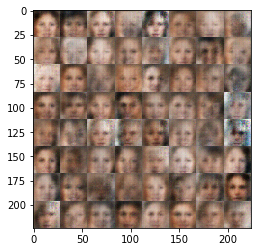

Epoch 1/1... Discriminator Loss: 0.0545... Generator Loss: 6.6967
Epoch 1/1... Discriminator Loss: 0.1699... Generator Loss: 3.5994
Epoch 1/1... Discriminator Loss: 0.0472... Generator Loss: 9.0614
Epoch 1/1... Discriminator Loss: 0.0530... Generator Loss: 6.2640
Epoch 1/1... Discriminator Loss: 0.0314... Generator Loss: 7.8748
Epoch 1/1... Discriminator Loss: 0.0268... Generator Loss: 7.1583
Epoch 1/1... Discriminator Loss: 0.1182... Generator Loss: 3.2742
Epoch 1/1... Discriminator Loss: 0.0308... Generator Loss: 5.1425
Epoch 1/1... Discriminator Loss: 0.0618... Generator Loss: 3.4213
Epoch 1/1... Discriminator Loss: 0.0268... Generator Loss: 4.5533


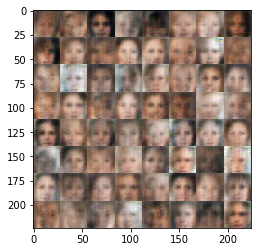

Epoch 1/1... Discriminator Loss: 0.3604... Generator Loss: 1.5086
Epoch 1/1... Discriminator Loss: 0.0841... Generator Loss: 9.3512
Epoch 1/1... Discriminator Loss: 0.1106... Generator Loss: 9.2946
Epoch 1/1... Discriminator Loss: 0.0969... Generator Loss: 5.1399
Epoch 1/1... Discriminator Loss: 0.0448... Generator Loss: 5.1716
Epoch 1/1... Discriminator Loss: 0.0792... Generator Loss: 3.3889
Epoch 1/1... Discriminator Loss: 0.0689... Generator Loss: 3.4209
Epoch 1/1... Discriminator Loss: 0.0497... Generator Loss: 5.1262
Epoch 1/1... Discriminator Loss: 0.1168... Generator Loss: 2.7329
Epoch 1/1... Discriminator Loss: 0.0461... Generator Loss: 9.1600


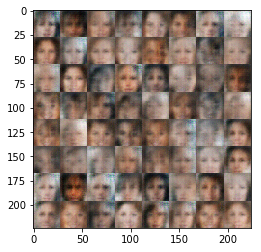

Epoch 1/1... Discriminator Loss: 0.0283... Generator Loss: 6.5329
Epoch 1/1... Discriminator Loss: 0.5850... Generator Loss: 1.0006
Epoch 1/1... Discriminator Loss: 0.4261... Generator Loss: 7.5108
Epoch 1/1... Discriminator Loss: 0.0927... Generator Loss: 4.3473
Epoch 1/1... Discriminator Loss: 0.0338... Generator Loss: 7.5644
Epoch 1/1... Discriminator Loss: 0.0483... Generator Loss: 3.8545
Epoch 1/1... Discriminator Loss: 0.0191... Generator Loss: 5.9812
Epoch 1/1... Discriminator Loss: 0.1689... Generator Loss: 2.3304
Epoch 1/1... Discriminator Loss: 0.0246... Generator Loss: 6.2890
Epoch 1/1... Discriminator Loss: 0.4141... Generator Loss: 1.4523


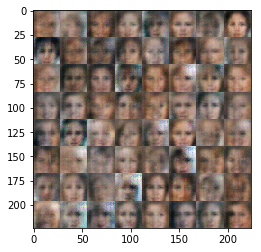

Epoch 1/1... Discriminator Loss: 0.1189... Generator Loss: 7.1042
Epoch 1/1... Discriminator Loss: 0.1962... Generator Loss: 3.4613
Epoch 1/1... Discriminator Loss: 0.0917... Generator Loss: 4.1378
Epoch 1/1... Discriminator Loss: 0.1769... Generator Loss: 2.2921
Epoch 1/1... Discriminator Loss: 0.0588... Generator Loss: 10.2113
Epoch 1/1... Discriminator Loss: 0.0524... Generator Loss: 8.5181
Epoch 1/1... Discriminator Loss: 0.3288... Generator Loss: 1.5229
Epoch 1/1... Discriminator Loss: 0.0677... Generator Loss: 9.8387
Epoch 1/1... Discriminator Loss: 0.0730... Generator Loss: 9.5999
Epoch 1/1... Discriminator Loss: 0.0371... Generator Loss: 8.3894


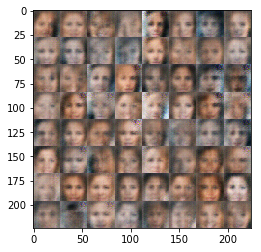

Epoch 1/1... Discriminator Loss: 0.0271... Generator Loss: 7.2513
Epoch 1/1... Discriminator Loss: 0.0357... Generator Loss: 6.0817
Epoch 1/1... Discriminator Loss: 0.0961... Generator Loss: 3.1923
Epoch 1/1... Discriminator Loss: 0.2426... Generator Loss: 2.4399
Epoch 1/1... Discriminator Loss: 0.0523... Generator Loss: 9.6433
Epoch 1/1... Discriminator Loss: 0.0349... Generator Loss: 10.3494
Epoch 1/1... Discriminator Loss: 0.0444... Generator Loss: 9.5966
Epoch 1/1... Discriminator Loss: 0.0331... Generator Loss: 8.6773
Epoch 1/1... Discriminator Loss: 0.0177... Generator Loss: 8.4332
Epoch 1/1... Discriminator Loss: 0.0222... Generator Loss: 7.6273


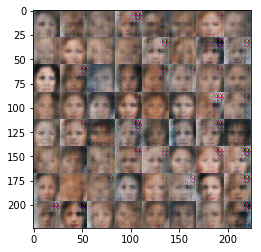

Epoch 1/1... Discriminator Loss: 0.0118... Generator Loss: 7.2767
Epoch 1/1... Discriminator Loss: 0.0144... Generator Loss: 6.9837
Epoch 1/1... Discriminator Loss: 0.0122... Generator Loss: 6.9415
Epoch 1/1... Discriminator Loss: 0.0117... Generator Loss: 6.7942
Epoch 1/1... Discriminator Loss: 0.0183... Generator Loss: 5.8356
Epoch 1/1... Discriminator Loss: 0.0203... Generator Loss: 5.6110
Epoch 1/1... Discriminator Loss: 0.0284... Generator Loss: 4.9707
Epoch 1/1... Discriminator Loss: 0.0536... Generator Loss: 4.0723
Epoch 1/1... Discriminator Loss: 0.1904... Generator Loss: 2.3584
Epoch 1/1... Discriminator Loss: 0.7204... Generator Loss: 0.8803


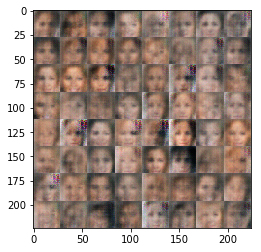

Epoch 1/1... Discriminator Loss: 0.1928... Generator Loss: 7.0519
Epoch 1/1... Discriminator Loss: 0.2350... Generator Loss: 6.0807
Epoch 1/1... Discriminator Loss: 0.0627... Generator Loss: 5.6849
Epoch 1/1... Discriminator Loss: 0.0490... Generator Loss: 3.8425
Epoch 1/1... Discriminator Loss: 0.0061... Generator Loss: 7.6318
Epoch 1/1... Discriminator Loss: 0.0196... Generator Loss: 4.8997
Epoch 1/1... Discriminator Loss: 0.0070... Generator Loss: 7.1355
Epoch 1/1... Discriminator Loss: 0.1051... Generator Loss: 2.8795
Epoch 1/1... Discriminator Loss: 0.0099... Generator Loss: 7.3005
Epoch 1/1... Discriminator Loss: 0.0102... Generator Loss: 5.8361


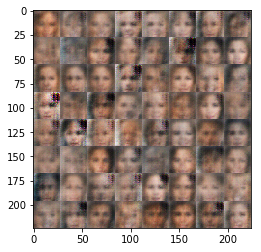

Epoch 1/1... Discriminator Loss: 0.2041... Generator Loss: 1.9454
Epoch 1/1... Discriminator Loss: 0.0367... Generator Loss: 6.4989
Epoch 1/1... Discriminator Loss: 0.6450... Generator Loss: 1.0073
Epoch 1/1... Discriminator Loss: 0.6928... Generator Loss: 10.1392
Epoch 1/1... Discriminator Loss: 0.0654... Generator Loss: 6.5980
Epoch 1/1... Discriminator Loss: 0.2582... Generator Loss: 1.7691
Epoch 1/1... Discriminator Loss: 0.0725... Generator Loss: 7.0888
Epoch 1/1... Discriminator Loss: 0.0992... Generator Loss: 4.1025
Epoch 1/1... Discriminator Loss: 0.0466... Generator Loss: 8.2296
Epoch 1/1... Discriminator Loss: 0.0844... Generator Loss: 3.1414


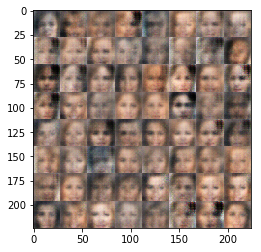

Epoch 1/1... Discriminator Loss: 0.0507... Generator Loss: 4.4420
Epoch 1/1... Discriminator Loss: 0.0881... Generator Loss: 3.4265
Epoch 1/1... Discriminator Loss: 0.0192... Generator Loss: 9.9753
Epoch 1/1... Discriminator Loss: 0.0119... Generator Loss: 7.1970
Epoch 1/1... Discriminator Loss: 0.0471... Generator Loss: 4.2852
Epoch 1/1... Discriminator Loss: 0.0281... Generator Loss: 4.6909
Epoch 1/1... Discriminator Loss: 0.1923... Generator Loss: 2.2326
Epoch 1/1... Discriminator Loss: 0.0396... Generator Loss: 6.1361
Epoch 1/1... Discriminator Loss: 0.6212... Generator Loss: 1.0448
Epoch 1/1... Discriminator Loss: 2.1268... Generator Loss: 10.4596


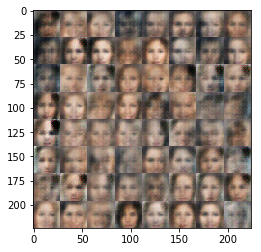

Epoch 1/1... Discriminator Loss: 0.0818... Generator Loss: 5.2459
Epoch 1/1... Discriminator Loss: 0.1369... Generator Loss: 2.6220
Epoch 1/1... Discriminator Loss: 0.0359... Generator Loss: 7.2479
Epoch 1/1... Discriminator Loss: 0.0267... Generator Loss: 6.8773
Epoch 1/1... Discriminator Loss: 0.1981... Generator Loss: 2.4255
Epoch 1/1... Discriminator Loss: 0.0691... Generator Loss: 3.6736
Epoch 1/1... Discriminator Loss: 2.3409... Generator Loss: 0.1283
Epoch 1/1... Discriminator Loss: 2.9404... Generator Loss: 6.9361
Epoch 1/1... Discriminator Loss: 0.0737... Generator Loss: 6.6143
Epoch 1/1... Discriminator Loss: 1.1440... Generator Loss: 0.6923


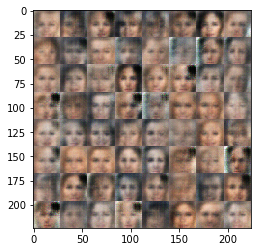

Epoch 1/1... Discriminator Loss: 0.2642... Generator Loss: 4.6056
Epoch 1/1... Discriminator Loss: 0.1423... Generator Loss: 6.8898
Epoch 1/1... Discriminator Loss: 0.6251... Generator Loss: 1.1665
Epoch 1/1... Discriminator Loss: 0.1033... Generator Loss: 7.0877
Epoch 1/1... Discriminator Loss: 0.1309... Generator Loss: 3.7938
Epoch 1/1... Discriminator Loss: 0.0941... Generator Loss: 3.8815
Epoch 1/1... Discriminator Loss: 0.3190... Generator Loss: 1.8189
Epoch 1/1... Discriminator Loss: 0.0516... Generator Loss: 7.9237
Epoch 1/1... Discriminator Loss: 0.0606... Generator Loss: 5.4724
Epoch 1/1... Discriminator Loss: 0.1466... Generator Loss: 2.5402


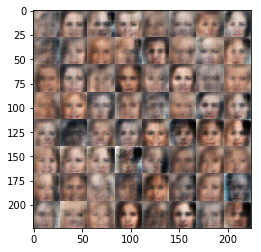

Epoch 1/1... Discriminator Loss: 0.0658... Generator Loss: 4.2832
Epoch 1/1... Discriminator Loss: 0.1555... Generator Loss: 2.3046
Epoch 1/1... Discriminator Loss: 0.1372... Generator Loss: 2.7770
Epoch 1/1... Discriminator Loss: 0.7053... Generator Loss: 0.8426
Epoch 1/1... Discriminator Loss: 1.7452... Generator Loss: 9.0356
Epoch 1/1... Discriminator Loss: 0.0708... Generator Loss: 6.1779
Epoch 1/1... Discriminator Loss: 0.0250... Generator Loss: 6.4073
Epoch 1/1... Discriminator Loss: 2.5864... Generator Loss: 0.0972
Epoch 1/1... Discriminator Loss: 1.5500... Generator Loss: 8.6259
Epoch 1/1... Discriminator Loss: 0.1987... Generator Loss: 4.0652


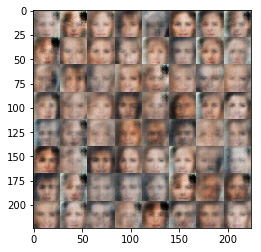

Epoch 1/1... Discriminator Loss: 0.1246... Generator Loss: 3.5193
Epoch 1/1... Discriminator Loss: 0.2557... Generator Loss: 2.1848
Epoch 1/1... Discriminator Loss: 0.1983... Generator Loss: 2.4050
Epoch 1/1... Discriminator Loss: 0.0712... Generator Loss: 8.5809
Epoch 1/1... Discriminator Loss: 0.0698... Generator Loss: 6.2106
Epoch 1/1... Discriminator Loss: 0.3371... Generator Loss: 1.8131
Epoch 1/1... Discriminator Loss: 0.0433... Generator Loss: 8.4618
Epoch 1/1... Discriminator Loss: 0.0335... Generator Loss: 7.2444
Epoch 1/1... Discriminator Loss: 0.1097... Generator Loss: 3.4549
Epoch 1/1... Discriminator Loss: 0.0256... Generator Loss: 6.7600


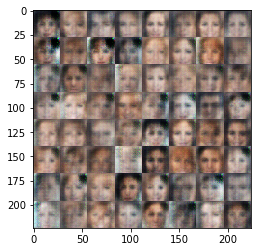

Epoch 1/1... Discriminator Loss: 0.1226... Generator Loss: 2.8115
Epoch 1/1... Discriminator Loss: 0.0312... Generator Loss: 6.8964
Epoch 1/1... Discriminator Loss: 0.0322... Generator Loss: 5.1737
Epoch 1/1... Discriminator Loss: 0.0243... Generator Loss: 6.1046
Epoch 1/1... Discriminator Loss: 0.0473... Generator Loss: 4.2938
Epoch 1/1... Discriminator Loss: 0.8910... Generator Loss: 0.7000
Epoch 1/1... Discriminator Loss: 1.1653... Generator Loss: 5.6437
Epoch 1/1... Discriminator Loss: 0.0615... Generator Loss: 4.4702
Epoch 1/1... Discriminator Loss: 0.0214... Generator Loss: 7.0355
Epoch 1/1... Discriminator Loss: 0.1751... Generator Loss: 2.4296


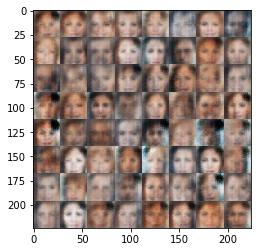

Epoch 1/1... Discriminator Loss: 0.0206... Generator Loss: 6.0805
Epoch 1/1... Discriminator Loss: 0.5684... Generator Loss: 1.0902
Epoch 1/1... Discriminator Loss: 0.0859... Generator Loss: 7.8719
Epoch 1/1... Discriminator Loss: 0.1222... Generator Loss: 6.1355
Epoch 1/1... Discriminator Loss: 0.1446... Generator Loss: 2.8867
Epoch 1/1... Discriminator Loss: 0.0860... Generator Loss: 4.6883
Epoch 1/1... Discriminator Loss: 0.3611... Generator Loss: 1.5668
Epoch 1/1... Discriminator Loss: 0.0952... Generator Loss: 11.8845
Epoch 1/1... Discriminator Loss: 0.0948... Generator Loss: 10.9940
Epoch 1/1... Discriminator Loss: 0.0366... Generator Loss: 8.8683


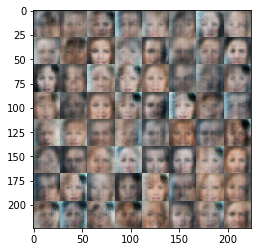

Epoch 1/1... Discriminator Loss: 0.0321... Generator Loss: 5.3285
Epoch 1/1... Discriminator Loss: 0.0582... Generator Loss: 3.9926
Epoch 1/1... Discriminator Loss: 0.0135... Generator Loss: 8.1912
Epoch 1/1... Discriminator Loss: 0.0178... Generator Loss: 6.5301
Epoch 1/1... Discriminator Loss: 0.2600... Generator Loss: 1.7010
Epoch 1/1... Discriminator Loss: 0.4396... Generator Loss: 1.2306
Epoch 1/1... Discriminator Loss: 0.2699... Generator Loss: 7.8536
Epoch 1/1... Discriminator Loss: 0.2013... Generator Loss: 3.6009
Epoch 1/1... Discriminator Loss: 0.0818... Generator Loss: 3.6514
Epoch 1/1... Discriminator Loss: 0.0573... Generator Loss: 4.7247


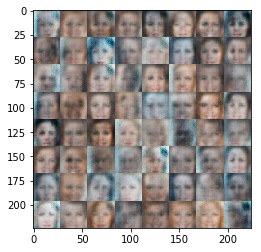

Epoch 1/1... Discriminator Loss: 0.0581... Generator Loss: 3.8611
Epoch 1/1... Discriminator Loss: 0.0276... Generator Loss: 4.8658
Epoch 1/1... Discriminator Loss: 0.2294... Generator Loss: 2.0222
Epoch 1/1... Discriminator Loss: 0.0822... Generator Loss: 7.2161
Epoch 1/1... Discriminator Loss: 0.5707... Generator Loss: 1.0444
Epoch 1/1... Discriminator Loss: 0.3532... Generator Loss: 11.0166
Epoch 1/1... Discriminator Loss: 0.1141... Generator Loss: 10.4188
Epoch 1/1... Discriminator Loss: 0.0307... Generator Loss: 9.8215
Epoch 1/1... Discriminator Loss: 0.0297... Generator Loss: 7.9284
Epoch 1/1... Discriminator Loss: 0.0137... Generator Loss: 6.6535


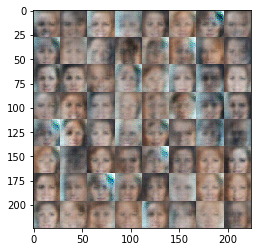

Epoch 1/1... Discriminator Loss: 0.0580... Generator Loss: 3.9115
Epoch 1/1... Discriminator Loss: 0.4614... Generator Loss: 1.3537
Epoch 1/1... Discriminator Loss: 0.0570... Generator Loss: 5.2939
Epoch 1/1... Discriminator Loss: 0.1216... Generator Loss: 6.1847
Epoch 1/1... Discriminator Loss: 0.0671... Generator Loss: 6.3935
Epoch 1/1... Discriminator Loss: 0.0947... Generator Loss: 3.4017
Epoch 1/1... Discriminator Loss: 0.0277... Generator Loss: 5.4940
Epoch 1/1... Discriminator Loss: 0.5812... Generator Loss: 1.1633
Epoch 1/1... Discriminator Loss: 0.2716... Generator Loss: 10.4363
Epoch 1/1... Discriminator Loss: 0.2142... Generator Loss: 9.2310


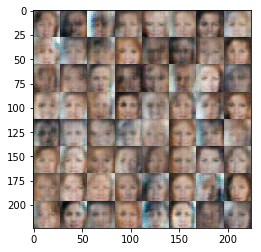

Epoch 1/1... Discriminator Loss: 0.0699... Generator Loss: 4.1336
Epoch 1/1... Discriminator Loss: 0.0351... Generator Loss: 4.8379
Epoch 1/1... Discriminator Loss: 0.3254... Generator Loss: 1.5139
Epoch 1/1... Discriminator Loss: 0.0555... Generator Loss: 5.8149
Epoch 1/1... Discriminator Loss: 0.2032... Generator Loss: 2.1996
Epoch 1/1... Discriminator Loss: 0.1185... Generator Loss: 7.9386
Epoch 1/1... Discriminator Loss: 0.0866... Generator Loss: 5.7422
Epoch 1/1... Discriminator Loss: 0.0575... Generator Loss: 6.2155
Epoch 1/1... Discriminator Loss: 0.3554... Generator Loss: 1.4456
Epoch 1/1... Discriminator Loss: 0.1603... Generator Loss: 11.3982


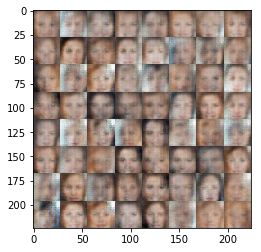

Epoch 1/1... Discriminator Loss: 0.1391... Generator Loss: 9.0744
Epoch 1/1... Discriminator Loss: 0.0679... Generator Loss: 3.8231
Epoch 1/1... Discriminator Loss: 0.0269... Generator Loss: 6.5119
Epoch 1/1... Discriminator Loss: 0.2144... Generator Loss: 2.2424
Epoch 1/1... Discriminator Loss: 0.0606... Generator Loss: 10.3744
Epoch 1/1... Discriminator Loss: 0.0317... Generator Loss: 10.8135
Epoch 1/1... Discriminator Loss: 0.0271... Generator Loss: 9.4864
Epoch 1/1... Discriminator Loss: 0.0189... Generator Loss: 7.6929
Epoch 1/1... Discriminator Loss: 0.0739... Generator Loss: 3.4859
Epoch 1/1... Discriminator Loss: 0.0300... Generator Loss: 4.8790


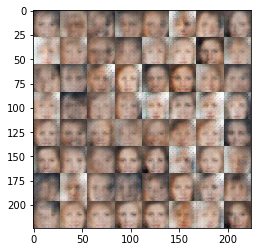

Epoch 1/1... Discriminator Loss: 0.0350... Generator Loss: 4.1147
Epoch 1/1... Discriminator Loss: 0.0538... Generator Loss: 3.7966
Epoch 1/1... Discriminator Loss: 0.0321... Generator Loss: 6.2702
Epoch 1/1... Discriminator Loss: 0.2304... Generator Loss: 2.0028
Epoch 1/1... Discriminator Loss: 0.0444... Generator Loss: 10.6953
Epoch 1/1... Discriminator Loss: 0.0325... Generator Loss: 10.2047
Epoch 1/1... Discriminator Loss: 0.0315... Generator Loss: 8.4372
Epoch 1/1... Discriminator Loss: 0.0189... Generator Loss: 7.7393
Epoch 1/1... Discriminator Loss: 0.0291... Generator Loss: 6.1053
Epoch 1/1... Discriminator Loss: 0.1172... Generator Loss: 2.9916


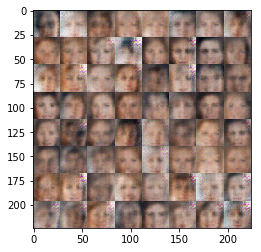

Epoch 1/1... Discriminator Loss: 0.0288... Generator Loss: 5.7321
Epoch 1/1... Discriminator Loss: 0.1217... Generator Loss: 2.6399
Epoch 1/1... Discriminator Loss: 0.0222... Generator Loss: 8.6520
Epoch 1/1... Discriminator Loss: 0.0523... Generator Loss: 4.3002
Epoch 1/1... Discriminator Loss: 0.0331... Generator Loss: 5.8987
Epoch 1/1... Discriminator Loss: 0.1013... Generator Loss: 2.7447
Epoch 1/1... Discriminator Loss: 0.0324... Generator Loss: 5.9895
Epoch 1/1... Discriminator Loss: 0.0835... Generator Loss: 3.3847
Epoch 1/1... Discriminator Loss: 0.0202... Generator Loss: 7.3787
Epoch 1/1... Discriminator Loss: 0.0293... Generator Loss: 5.4475


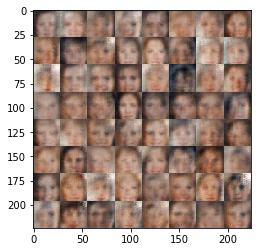

Epoch 1/1... Discriminator Loss: 2.2653... Generator Loss: 0.1705
Epoch 1/1... Discriminator Loss: 3.0295... Generator Loss: 10.4998
Epoch 1/1... Discriminator Loss: 0.2554... Generator Loss: 6.9832
Epoch 1/1... Discriminator Loss: 0.9477... Generator Loss: 0.9546
Epoch 1/1... Discriminator Loss: 0.0703... Generator Loss: 8.6274
Epoch 1/1... Discriminator Loss: 0.1226... Generator Loss: 7.5867
Epoch 1/1... Discriminator Loss: 0.2715... Generator Loss: 1.9452
Epoch 1/1... Discriminator Loss: 0.0681... Generator Loss: 6.2232
Epoch 1/1... Discriminator Loss: 0.1143... Generator Loss: 3.0478
Epoch 1/1... Discriminator Loss: 0.0385... Generator Loss: 5.7196


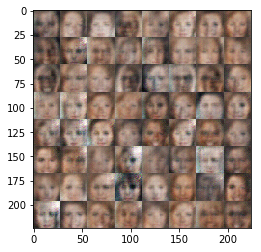

Epoch 1/1... Discriminator Loss: 0.1722... Generator Loss: 2.6803
Epoch 1/1... Discriminator Loss: 0.2551... Generator Loss: 1.9151
Epoch 1/1... Discriminator Loss: 0.0776... Generator Loss: 6.8926
Epoch 1/1... Discriminator Loss: 0.4678... Generator Loss: 1.4531
Epoch 1/1... Discriminator Loss: 0.2989... Generator Loss: 7.0739
Epoch 1/1... Discriminator Loss: 0.2672... Generator Loss: 2.2183
Epoch 1/1... Discriminator Loss: 0.0782... Generator Loss: 6.4428
Epoch 1/1... Discriminator Loss: 0.4290... Generator Loss: 1.4328
Epoch 1/1... Discriminator Loss: 0.1090... Generator Loss: 7.0511
Epoch 1/1... Discriminator Loss: 0.0941... Generator Loss: 7.3412


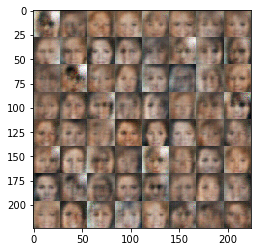

Epoch 1/1... Discriminator Loss: 0.0544... Generator Loss: 5.0603
Epoch 1/1... Discriminator Loss: 0.0379... Generator Loss: 6.7304
Epoch 1/1... Discriminator Loss: 1.6874... Generator Loss: 0.2993
Epoch 1/1... Discriminator Loss: 2.6708... Generator Loss: 10.4799
Epoch 1/1... Discriminator Loss: 0.3112... Generator Loss: 5.3974
Epoch 1/1... Discriminator Loss: 0.0603... Generator Loss: 5.2807
Epoch 1/1... Discriminator Loss: 1.5758... Generator Loss: 0.4676
Epoch 1/1... Discriminator Loss: 0.6568... Generator Loss: 8.6402
Epoch 1/1... Discriminator Loss: 0.1764... Generator Loss: 3.1386
Epoch 1/1... Discriminator Loss: 0.0313... Generator Loss: 5.5921


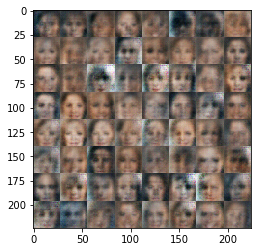

Epoch 1/1... Discriminator Loss: 0.0434... Generator Loss: 4.2371
Epoch 1/1... Discriminator Loss: 0.0215... Generator Loss: 6.4059
Epoch 1/1... Discriminator Loss: 0.4172... Generator Loss: 1.6218
Epoch 1/1... Discriminator Loss: 0.0262... Generator Loss: 6.7192
Epoch 1/1... Discriminator Loss: 0.0515... Generator Loss: 4.8583
Epoch 1/1... Discriminator Loss: 0.2381... Generator Loss: 1.9759
Epoch 1/1... Discriminator Loss: 0.0631... Generator Loss: 8.6599
Epoch 1/1... Discriminator Loss: 0.0485... Generator Loss: 7.0192
Epoch 1/1... Discriminator Loss: 0.3314... Generator Loss: 1.5860
Epoch 1/1... Discriminator Loss: 0.0576... Generator Loss: 4.7660


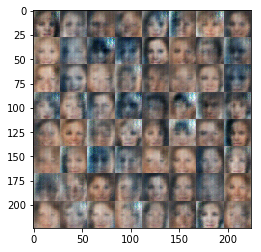

Epoch 1/1... Discriminator Loss: 0.9657... Generator Loss: 0.5779
Epoch 1/1... Discriminator Loss: 1.0427... Generator Loss: 8.9799
Epoch 1/1... Discriminator Loss: 0.0841... Generator Loss: 5.2826
Epoch 1/1... Discriminator Loss: 0.0582... Generator Loss: 4.3399
Epoch 1/1... Discriminator Loss: 0.0236... Generator Loss: 6.1633
Epoch 1/1... Discriminator Loss: 0.0473... Generator Loss: 4.3818
Epoch 1/1... Discriminator Loss: 0.1214... Generator Loss: 3.2236
Epoch 1/1... Discriminator Loss: 0.3032... Generator Loss: 1.9381
Epoch 1/1... Discriminator Loss: 0.1405... Generator Loss: 3.5762
Epoch 1/1... Discriminator Loss: 0.2571... Generator Loss: 3.0186


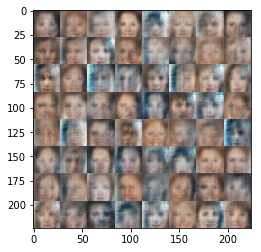

Epoch 1/1... Discriminator Loss: 0.0898... Generator Loss: 5.7408
Epoch 1/1... Discriminator Loss: 0.2235... Generator Loss: 2.2276
Epoch 1/1... Discriminator Loss: 0.0274... Generator Loss: 7.7597
Epoch 1/1... Discriminator Loss: 0.0910... Generator Loss: 3.3805
Epoch 1/1... Discriminator Loss: 0.0342... Generator Loss: 5.6752
Epoch 1/1... Discriminator Loss: 0.0344... Generator Loss: 4.5145
Epoch 1/1... Discriminator Loss: 0.9143... Generator Loss: 0.6120
Epoch 1/1... Discriminator Loss: 0.5733... Generator Loss: 7.2917
Epoch 1/1... Discriminator Loss: 0.1791... Generator Loss: 5.1058
Epoch 1/1... Discriminator Loss: 0.0331... Generator Loss: 6.2420


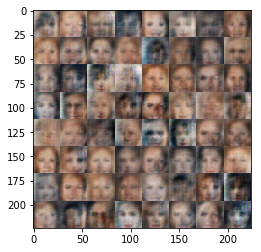

Epoch 1/1... Discriminator Loss: 0.6432... Generator Loss: 1.0444
Epoch 1/1... Discriminator Loss: 0.1682... Generator Loss: 6.2702
Epoch 1/1... Discriminator Loss: 0.1850... Generator Loss: 4.8387
Epoch 1/1... Discriminator Loss: 0.0625... Generator Loss: 9.7978
Epoch 1/1... Discriminator Loss: 0.0330... Generator Loss: 8.8754
Epoch 1/1... Discriminator Loss: 0.0438... Generator Loss: 5.2939
Epoch 1/1... Discriminator Loss: 0.0438... Generator Loss: 4.2478
Epoch 1/1... Discriminator Loss: 0.0214... Generator Loss: 4.8140
Epoch 1/1... Discriminator Loss: 0.3765... Generator Loss: 1.5213
Epoch 1/1... Discriminator Loss: 0.0563... Generator Loss: 8.3792


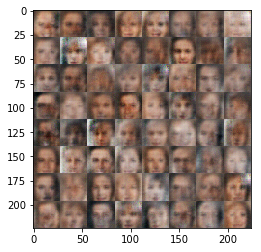

Epoch 1/1... Discriminator Loss: 0.2101... Generator Loss: 6.1767
Epoch 1/1... Discriminator Loss: 0.0713... Generator Loss: 6.0806
Epoch 1/1... Discriminator Loss: 0.6055... Generator Loss: 1.0461
Epoch 1/1... Discriminator Loss: 0.4558... Generator Loss: 8.1143
Epoch 1/1... Discriminator Loss: 0.1500... Generator Loss: 3.9692
Epoch 1/1... Discriminator Loss: 0.0416... Generator Loss: 6.9698
Epoch 1/1... Discriminator Loss: 0.4341... Generator Loss: 1.3866
Epoch 1/1... Discriminator Loss: 0.0788... Generator Loss: 3.5034
Epoch 1/1... Discriminator Loss: 0.0817... Generator Loss: 5.9608
Epoch 1/1... Discriminator Loss: 0.0550... Generator Loss: 10.8978


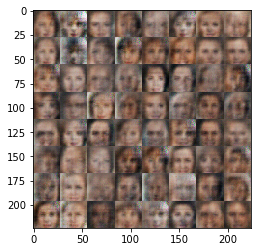

Epoch 1/1... Discriminator Loss: 0.0285... Generator Loss: 10.5513
Epoch 1/1... Discriminator Loss: 0.0384... Generator Loss: 9.3860
Epoch 1/1... Discriminator Loss: 0.0179... Generator Loss: 8.1078
Epoch 1/1... Discriminator Loss: 0.0223... Generator Loss: 6.0328
Epoch 1/1... Discriminator Loss: 0.4673... Generator Loss: 1.4077
Epoch 1/1... Discriminator Loss: 0.0427... Generator Loss: 8.3763
Epoch 1/1... Discriminator Loss: 0.0629... Generator Loss: 8.7820
Epoch 1/1... Discriminator Loss: 0.0493... Generator Loss: 7.8270
Epoch 1/1... Discriminator Loss: 0.0508... Generator Loss: 6.8745
Epoch 1/1... Discriminator Loss: 0.0379... Generator Loss: 5.8472


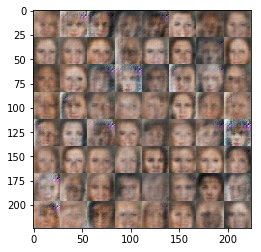

Epoch 1/1... Discriminator Loss: 0.0797... Generator Loss: 3.1972
Epoch 1/1... Discriminator Loss: 0.0533... Generator Loss: 3.8455
Epoch 1/1... Discriminator Loss: 0.0222... Generator Loss: 10.1626
Epoch 1/1... Discriminator Loss: 0.0217... Generator Loss: 9.7120
Epoch 1/1... Discriminator Loss: 0.0159... Generator Loss: 8.5895
Epoch 1/1... Discriminator Loss: 0.0152... Generator Loss: 6.8406
Epoch 1/1... Discriminator Loss: 0.4692... Generator Loss: 1.1342
Epoch 1/1... Discriminator Loss: 0.0854... Generator Loss: 8.7791
Epoch 1/1... Discriminator Loss: 0.1200... Generator Loss: 7.9402
Epoch 1/1... Discriminator Loss: 0.1078... Generator Loss: 3.0658


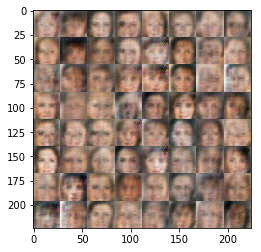

Epoch 1/1... Discriminator Loss: 0.0352... Generator Loss: 8.4144
Epoch 1/1... Discriminator Loss: 0.0279... Generator Loss: 6.7507
Epoch 1/1... Discriminator Loss: 0.1559... Generator Loss: 2.5179
Epoch 1/1... Discriminator Loss: 0.0264... Generator Loss: 9.8596
Epoch 1/1... Discriminator Loss: 0.0257... Generator Loss: 9.5885
Epoch 1/1... Discriminator Loss: 0.0162... Generator Loss: 8.4386
Epoch 1/1... Discriminator Loss: 0.0211... Generator Loss: 6.6018
Epoch 1/1... Discriminator Loss: 0.0196... Generator Loss: 5.3311
Epoch 1/1... Discriminator Loss: 0.0533... Generator Loss: 3.3645
Epoch 1/1... Discriminator Loss: 0.3088... Generator Loss: 1.5102


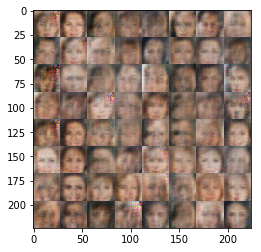

Epoch 1/1... Discriminator Loss: 0.0853... Generator Loss: 11.1306
Epoch 1/1... Discriminator Loss: 0.1265... Generator Loss: 10.0962
Epoch 1/1... Discriminator Loss: 0.0456... Generator Loss: 10.7252
Epoch 1/1... Discriminator Loss: 0.0183... Generator Loss: 9.5540
Epoch 1/1... Discriminator Loss: 0.0114... Generator Loss: 9.4882
Epoch 1/1... Discriminator Loss: 0.0082... Generator Loss: 9.1795
Epoch 1/1... Discriminator Loss: 0.0093... Generator Loss: 8.5533
Epoch 1/1... Discriminator Loss: 0.0086... Generator Loss: 7.8995
Epoch 1/1... Discriminator Loss: 0.0099... Generator Loss: 7.1623
Epoch 1/1... Discriminator Loss: 0.0135... Generator Loss: 6.5513


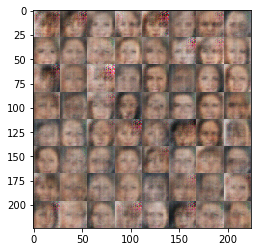

Epoch 1/1... Discriminator Loss: 0.0122... Generator Loss: 7.6128
Epoch 1/1... Discriminator Loss: 0.0112... Generator Loss: 6.8655
Epoch 1/1... Discriminator Loss: 0.0127... Generator Loss: 6.7036
Epoch 1/1... Discriminator Loss: 0.0198... Generator Loss: 5.3408
Epoch 1/1... Discriminator Loss: 0.0300... Generator Loss: 4.7356
Epoch 1/1... Discriminator Loss: 0.1232... Generator Loss: 2.7095
Epoch 1/1... Discriminator Loss: 0.0897... Generator Loss: 2.6542
Epoch 1/1... Discriminator Loss: 0.0135... Generator Loss: 8.7981
Epoch 1/1... Discriminator Loss: 0.0633... Generator Loss: 4.2455
Epoch 1/1... Discriminator Loss: 0.0246... Generator Loss: 7.4711


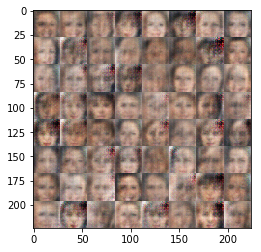

Epoch 1/1... Discriminator Loss: 0.0475... Generator Loss: 3.7824
Epoch 1/1... Discriminator Loss: 0.0750... Generator Loss: 3.2135
Epoch 1/1... Discriminator Loss: 0.0162... Generator Loss: 8.6022
Epoch 1/1... Discriminator Loss: 0.0291... Generator Loss: 8.4462
Epoch 1/1... Discriminator Loss: 0.0174... Generator Loss: 8.0318
Epoch 1/1... Discriminator Loss: 0.0164... Generator Loss: 6.1505
Epoch 1/1... Discriminator Loss: 0.0625... Generator Loss: 3.5702
Epoch 1/1... Discriminator Loss: 0.0562... Generator Loss: 3.8701
Epoch 1/1... Discriminator Loss: 0.0156... Generator Loss: 7.1709
Epoch 1/1... Discriminator Loss: 0.0138... Generator Loss: 6.6675


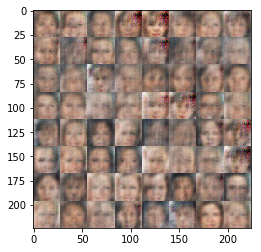

Epoch 1/1... Discriminator Loss: 0.1061... Generator Loss: 2.9768
Epoch 1/1... Discriminator Loss: 0.0207... Generator Loss: 8.8889
Epoch 1/1... Discriminator Loss: 0.0199... Generator Loss: 7.7895
Epoch 1/1... Discriminator Loss: 0.0299... Generator Loss: 6.2998
Epoch 1/1... Discriminator Loss: 0.0646... Generator Loss: 3.6198
Epoch 1/1... Discriminator Loss: 0.0068... Generator Loss: 8.2130
Epoch 1/1... Discriminator Loss: 0.0089... Generator Loss: 7.7388
Epoch 1/1... Discriminator Loss: 0.0263... Generator Loss: 5.5371
Epoch 1/1... Discriminator Loss: 0.0697... Generator Loss: 3.6222
Epoch 1/1... Discriminator Loss: 0.0252... Generator Loss: 4.6308


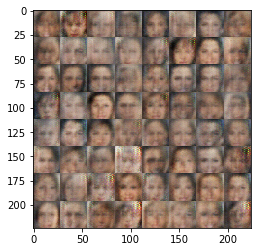

Epoch 1/1... Discriminator Loss: 0.0231... Generator Loss: 4.7989
Epoch 1/1... Discriminator Loss: 0.0101... Generator Loss: 7.0124
Epoch 1/1... Discriminator Loss: 2.0627... Generator Loss: 0.1775
Epoch 1/1... Discriminator Loss: 0.8216... Generator Loss: 11.2947
Epoch 1/1... Discriminator Loss: 0.1203... Generator Loss: 10.3459
Epoch 1/1... Discriminator Loss: 0.0376... Generator Loss: 9.2680
Epoch 1/1... Discriminator Loss: 0.0133... Generator Loss: 7.4050
Epoch 1/1... Discriminator Loss: 0.0201... Generator Loss: 6.4165
Epoch 1/1... Discriminator Loss: 0.1051... Generator Loss: 3.2797
Epoch 1/1... Discriminator Loss: 0.0409... Generator Loss: 4.3188


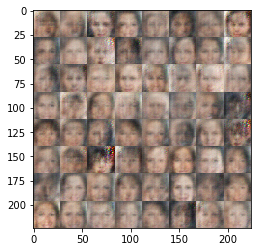

Epoch 1/1... Discriminator Loss: 0.0204... Generator Loss: 6.3069
Epoch 1/1... Discriminator Loss: 0.2787... Generator Loss: 1.7811
Epoch 1/1... Discriminator Loss: 0.0237... Generator Loss: 7.4082
Epoch 1/1... Discriminator Loss: 0.0447... Generator Loss: 5.8531
Epoch 1/1... Discriminator Loss: 1.1171... Generator Loss: 0.5208
Epoch 1/1... Discriminator Loss: 1.6208... Generator Loss: 10.4993
Epoch 1/1... Discriminator Loss: 0.0966... Generator Loss: 8.3453
Epoch 1/1... Discriminator Loss: 0.1005... Generator Loss: 4.4861
Epoch 1/1... Discriminator Loss: 0.0350... Generator Loss: 6.1737
Epoch 1/1... Discriminator Loss: 0.1236... Generator Loss: 2.4902


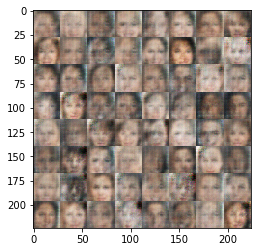

Epoch 1/1... Discriminator Loss: 0.0166... Generator Loss: 5.2613
Epoch 1/1... Discriminator Loss: 0.0539... Generator Loss: 4.0117
Epoch 1/1... Discriminator Loss: 2.7922... Generator Loss: 0.1023
Epoch 1/1... Discriminator Loss: 2.9450... Generator Loss: 6.7483
Epoch 1/1... Discriminator Loss: 0.0623... Generator Loss: 4.2400
Epoch 1/1... Discriminator Loss: 0.0246... Generator Loss: 6.1439
Epoch 1/1... Discriminator Loss: 0.1905... Generator Loss: 2.5490
Epoch 1/1... Discriminator Loss: 0.0327... Generator Loss: 8.8506
Epoch 1/1... Discriminator Loss: 0.0205... Generator Loss: 6.9479
Epoch 1/1... Discriminator Loss: 0.0300... Generator Loss: 5.4644


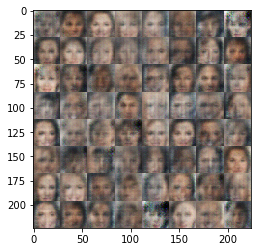

Epoch 1/1... Discriminator Loss: 0.2012... Generator Loss: 2.5655
Epoch 1/1... Discriminator Loss: 0.0756... Generator Loss: 4.8574
Epoch 1/1... Discriminator Loss: 0.1694... Generator Loss: 3.1705
Epoch 1/1... Discriminator Loss: 0.0938... Generator Loss: 6.5766
Epoch 1/1... Discriminator Loss: 1.1578... Generator Loss: 0.4945
Epoch 1/1... Discriminator Loss: 1.5159... Generator Loss: 6.2020
Epoch 1/1... Discriminator Loss: 0.0503... Generator Loss: 4.1633
Epoch 1/1... Discriminator Loss: 0.0401... Generator Loss: 4.8539
Epoch 1/1... Discriminator Loss: 1.4613... Generator Loss: 0.4340
Epoch 1/1... Discriminator Loss: 0.3033... Generator Loss: 7.3118


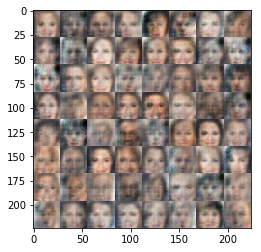

Epoch 1/1... Discriminator Loss: 0.4104... Generator Loss: 3.0547
Epoch 1/1... Discriminator Loss: 0.1153... Generator Loss: 3.2425
Epoch 1/1... Discriminator Loss: 0.7098... Generator Loss: 0.8377
Epoch 1/1... Discriminator Loss: 0.1421... Generator Loss: 9.2307
Epoch 1/1... Discriminator Loss: 0.2415... Generator Loss: 4.7729
Epoch 1/1... Discriminator Loss: 0.0831... Generator Loss: 10.1187
Epoch 1/1... Discriminator Loss: 0.0333... Generator Loss: 7.4701
Epoch 1/1... Discriminator Loss: 0.0333... Generator Loss: 4.5729
Epoch 1/1... Discriminator Loss: 0.9695... Generator Loss: 0.6045
Epoch 1/1... Discriminator Loss: 0.4048... Generator Loss: 2.6694


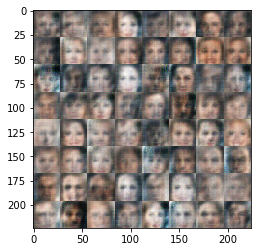

Epoch 1/1... Discriminator Loss: 0.3655... Generator Loss: 5.0443
Epoch 1/1... Discriminator Loss: 0.0983... Generator Loss: 3.5922
Epoch 1/1... Discriminator Loss: 0.0348... Generator Loss: 6.9469
Epoch 1/1... Discriminator Loss: 0.1591... Generator Loss: 2.3478
Epoch 1/1... Discriminator Loss: 0.0370... Generator Loss: 7.3566
Epoch 1/1... Discriminator Loss: 0.0675... Generator Loss: 4.5083
Epoch 1/1... Discriminator Loss: 0.9230... Generator Loss: 0.6216
Epoch 1/1... Discriminator Loss: 3.6992... Generator Loss: 4.5118
Epoch 1/1... Discriminator Loss: 0.1396... Generator Loss: 5.4070
Epoch 1/1... Discriminator Loss: 0.0435... Generator Loss: 9.6705


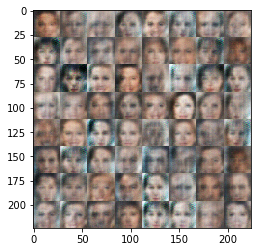

Epoch 1/1... Discriminator Loss: 0.0210... Generator Loss: 7.2528
Epoch 1/1... Discriminator Loss: 0.0987... Generator Loss: 3.0546
Epoch 1/1... Discriminator Loss: 0.6665... Generator Loss: 1.0684
Epoch 1/1... Discriminator Loss: 0.1607... Generator Loss: 6.9815
Epoch 1/1... Discriminator Loss: 0.7482... Generator Loss: 0.9495
Epoch 1/1... Discriminator Loss: 0.6205... Generator Loss: 9.7310
Epoch 1/1... Discriminator Loss: 0.1041... Generator Loss: 8.1052
Epoch 1/1... Discriminator Loss: 0.1084... Generator Loss: 3.1905
Epoch 1/1... Discriminator Loss: 0.0298... Generator Loss: 8.0708
Epoch 1/1... Discriminator Loss: 0.0184... Generator Loss: 5.7378


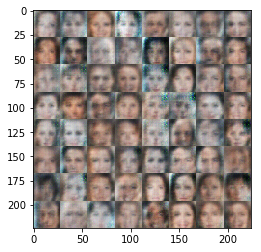

Epoch 1/1... Discriminator Loss: 0.3093... Generator Loss: 1.8455
Epoch 1/1... Discriminator Loss: 0.0150... Generator Loss: 6.4813
Epoch 1/1... Discriminator Loss: 0.0954... Generator Loss: 2.9268
Epoch 1/1... Discriminator Loss: 0.0214... Generator Loss: 7.6336
Epoch 1/1... Discriminator Loss: 0.7045... Generator Loss: 0.8984
Epoch 1/1... Discriminator Loss: 0.2100... Generator Loss: 8.6869
Epoch 1/1... Discriminator Loss: 0.1678... Generator Loss: 5.9436
Epoch 1/1... Discriminator Loss: 0.1169... Generator Loss: 3.0155
Epoch 1/1... Discriminator Loss: 0.0501... Generator Loss: 9.3930
Epoch 1/1... Discriminator Loss: 0.0376... Generator Loss: 5.1238


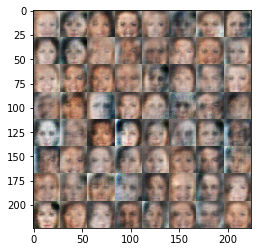

Epoch 1/1... Discriminator Loss: 0.0246... Generator Loss: 7.7195
Epoch 1/1... Discriminator Loss: 0.1161... Generator Loss: 2.7810
Epoch 1/1... Discriminator Loss: 0.0141... Generator Loss: 8.0786
Epoch 1/1... Discriminator Loss: 0.0208... Generator Loss: 6.6931
Epoch 1/1... Discriminator Loss: 0.1394... Generator Loss: 2.5100
Epoch 1/1... Discriminator Loss: 0.0156... Generator Loss: 7.9193
Epoch 1/1... Discriminator Loss: 0.0463... Generator Loss: 4.0495
Epoch 1/1... Discriminator Loss: 0.0301... Generator Loss: 4.3619
Epoch 1/1... Discriminator Loss: 0.0737... Generator Loss: 3.1929
Epoch 1/1... Discriminator Loss: 0.0381... Generator Loss: 5.2641


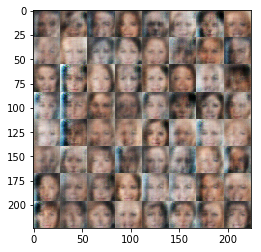

Epoch 1/1... Discriminator Loss: 1.5404... Generator Loss: 0.3072
Epoch 1/1... Discriminator Loss: 1.2198... Generator Loss: 8.9107
Epoch 1/1... Discriminator Loss: 0.1474... Generator Loss: 5.5267
Epoch 1/1... Discriminator Loss: 0.0797... Generator Loss: 3.5956
Epoch 1/1... Discriminator Loss: 0.0684... Generator Loss: 3.7247
Epoch 1/1... Discriminator Loss: 0.0947... Generator Loss: 3.1219
Epoch 1/1... Discriminator Loss: 0.0226... Generator Loss: 6.9642
Epoch 1/1... Discriminator Loss: 0.4524... Generator Loss: 1.1638
Epoch 1/1... Discriminator Loss: 0.0338... Generator Loss: 8.1806
Epoch 1/1... Discriminator Loss: 0.0386... Generator Loss: 5.4978


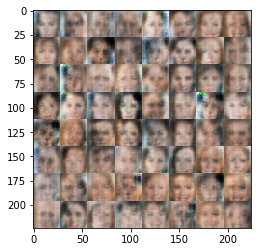

Epoch 1/1... Discriminator Loss: 0.1195... Generator Loss: 2.6150
Epoch 1/1... Discriminator Loss: 0.0319... Generator Loss: 9.3884
Epoch 1/1... Discriminator Loss: 0.0366... Generator Loss: 4.5618
Epoch 1/1... Discriminator Loss: 0.0296... Generator Loss: 8.2065
Epoch 1/1... Discriminator Loss: 0.0532... Generator Loss: 3.8086
Epoch 1/1... Discriminator Loss: 0.0161... Generator Loss: 6.7510
Epoch 1/1... Discriminator Loss: 0.1264... Generator Loss: 2.4528
Epoch 1/1... Discriminator Loss: 0.0252... Generator Loss: 6.4755
Epoch 1/1... Discriminator Loss: 0.0523... Generator Loss: 3.5391
Epoch 1/1... Discriminator Loss: 0.2398... Generator Loss: 1.7928


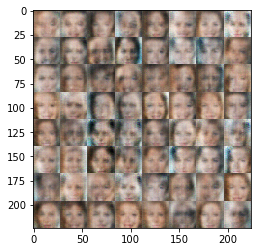

Epoch 1/1... Discriminator Loss: 0.0692... Generator Loss: 4.9497
Epoch 1/1... Discriminator Loss: 0.1145... Generator Loss: 9.0066
Epoch 1/1... Discriminator Loss: 0.0705... Generator Loss: 5.2352
Epoch 1/1... Discriminator Loss: 0.0457... Generator Loss: 4.8697
Epoch 1/1... Discriminator Loss: 0.0280... Generator Loss: 9.5921
Epoch 1/1... Discriminator Loss: 0.0176... Generator Loss: 6.5965
Epoch 1/1... Discriminator Loss: 0.0663... Generator Loss: 3.2630
Epoch 1/1... Discriminator Loss: 0.0514... Generator Loss: 3.7347
Epoch 1/1... Discriminator Loss: 0.6242... Generator Loss: 0.9468
Epoch 1/1... Discriminator Loss: 0.4633... Generator Loss: 5.4424


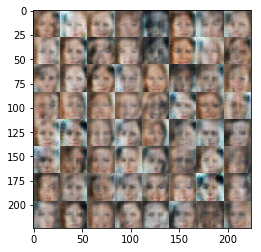

Epoch 1/1... Discriminator Loss: 1.5972... Generator Loss: 0.2913
Epoch 1/1... Discriminator Loss: 5.8709... Generator Loss: 6.1739
Epoch 1/1... Discriminator Loss: 0.2278... Generator Loss: 3.3652
Epoch 1/1... Discriminator Loss: 0.0217... Generator Loss: 8.3263
Epoch 1/1... Discriminator Loss: 0.0686... Generator Loss: 3.3843
Epoch 1/1... Discriminator Loss: 0.0110... Generator Loss: 7.1664
Epoch 1/1... Discriminator Loss: 0.0317... Generator Loss: 4.3392
Epoch 1/1... Discriminator Loss: 1.1914... Generator Loss: 0.4355
Epoch 1/1... Discriminator Loss: 0.6564... Generator Loss: 7.5121
Epoch 1/1... Discriminator Loss: 0.1861... Generator Loss: 2.7825


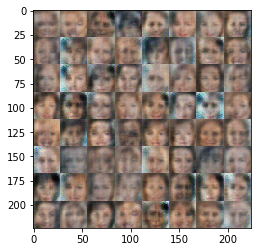

Epoch 1/1... Discriminator Loss: 0.0324... Generator Loss: 5.6532
Epoch 1/1... Discriminator Loss: 1.1424... Generator Loss: 0.5597
Epoch 1/1... Discriminator Loss: 0.0847... Generator Loss: 5.6785
Epoch 1/1... Discriminator Loss: 0.3143... Generator Loss: 2.1652
Epoch 1/1... Discriminator Loss: 0.1197... Generator Loss: 4.4898
Epoch 1/1... Discriminator Loss: 0.2700... Generator Loss: 1.9670
Epoch 1/1... Discriminator Loss: 0.0484... Generator Loss: 10.4932
Epoch 1/1... Discriminator Loss: 0.0391... Generator Loss: 10.0240
Epoch 1/1... Discriminator Loss: 0.0325... Generator Loss: 6.4345
Epoch 1/1... Discriminator Loss: 0.0797... Generator Loss: 3.2012


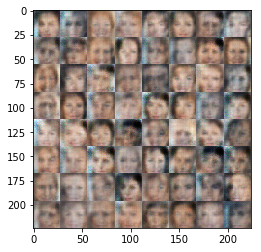

Epoch 1/1... Discriminator Loss: 0.0405... Generator Loss: 4.4488
Epoch 1/1... Discriminator Loss: 0.2885... Generator Loss: 1.8819
Epoch 1/1... Discriminator Loss: 0.1151... Generator Loss: 4.3198
Epoch 1/1... Discriminator Loss: 0.1817... Generator Loss: 3.1885
Epoch 1/1... Discriminator Loss: 0.0860... Generator Loss: 7.5763
Epoch 1/1... Discriminator Loss: 0.1747... Generator Loss: 2.2607
Epoch 1/1... Discriminator Loss: 0.0479... Generator Loss: 4.2759
Epoch 1/1... Discriminator Loss: 0.0253... Generator Loss: 5.8967
Epoch 1/1... Discriminator Loss: 0.4019... Generator Loss: 1.3159
Epoch 1/1... Discriminator Loss: 0.0746... Generator Loss: 6.0415


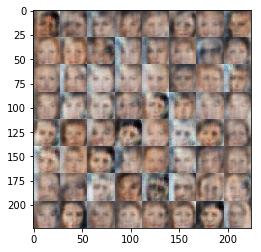

Epoch 1/1... Discriminator Loss: 0.2967... Generator Loss: 1.9139
Epoch 1/1... Discriminator Loss: 0.1588... Generator Loss: 10.0372
Epoch 1/1... Discriminator Loss: 0.0682... Generator Loss: 8.5016
Epoch 1/1... Discriminator Loss: 0.0397... Generator Loss: 4.4689
Epoch 1/1... Discriminator Loss: 2.8769... Generator Loss: 0.0687
Epoch 1/1... Discriminator Loss: 2.3104... Generator Loss: 5.9771
Epoch 1/1... Discriminator Loss: 0.2171... Generator Loss: 3.9734
Epoch 1/1... Discriminator Loss: 0.0583... Generator Loss: 9.8601
Epoch 1/1... Discriminator Loss: 0.0344... Generator Loss: 7.4486
Epoch 1/1... Discriminator Loss: 0.2073... Generator Loss: 2.2893


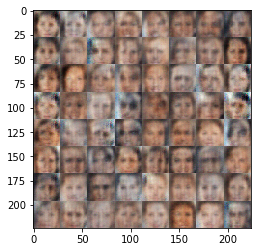

Epoch 1/1... Discriminator Loss: 0.0266... Generator Loss: 4.9632
Epoch 1/1... Discriminator Loss: 0.0629... Generator Loss: 3.4927
Epoch 1/1... Discriminator Loss: 0.0588... Generator Loss: 4.0307
Epoch 1/1... Discriminator Loss: 0.7009... Generator Loss: 0.8731
Epoch 1/1... Discriminator Loss: 0.4408... Generator Loss: 7.8470
Epoch 1/1... Discriminator Loss: 0.2237... Generator Loss: 3.5889
Epoch 1/1... Discriminator Loss: 0.0431... Generator Loss: 6.7815
Epoch 1/1... Discriminator Loss: 0.1770... Generator Loss: 2.2889
Epoch 1/1... Discriminator Loss: 0.0291... Generator Loss: 5.1607
Epoch 1/1... Discriminator Loss: 0.0885... Generator Loss: 3.1351


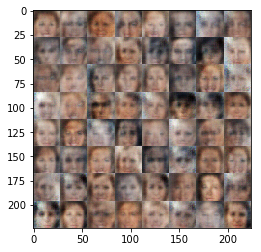

Epoch 1/1... Discriminator Loss: 0.1255... Generator Loss: 2.7718
Epoch 1/1... Discriminator Loss: 0.0400... Generator Loss: 6.3666
Epoch 1/1... Discriminator Loss: 0.9461... Generator Loss: 0.6439
Epoch 1/1... Discriminator Loss: 0.3749... Generator Loss: 5.8403
Epoch 1/1... Discriminator Loss: 0.2162... Generator Loss: 4.7130
Epoch 1/1... Discriminator Loss: 0.0519... Generator Loss: 7.7792
Epoch 1/1... Discriminator Loss: 0.2181... Generator Loss: 1.8887
Epoch 1/1... Discriminator Loss: 0.0474... Generator Loss: 5.1728
Epoch 1/1... Discriminator Loss: 0.3181... Generator Loss: 1.5923
Epoch 1/1... Discriminator Loss: 0.2331... Generator Loss: 3.9604


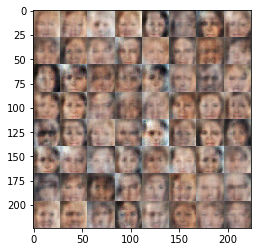

Epoch 1/1... Discriminator Loss: 0.1590... Generator Loss: 5.0793
Epoch 1/1... Discriminator Loss: 0.0786... Generator Loss: 3.8139
Epoch 1/1... Discriminator Loss: 0.0330... Generator Loss: 8.1125
Epoch 1/1... Discriminator Loss: 0.0891... Generator Loss: 2.9212
Epoch 1/1... Discriminator Loss: 0.0219... Generator Loss: 8.7562
Epoch 1/1... Discriminator Loss: 0.0205... Generator Loss: 6.0269
Epoch 1/1... Discriminator Loss: 0.0893... Generator Loss: 2.9751
Epoch 1/1... Discriminator Loss: 0.0158... Generator Loss: 8.0310
Epoch 1/1... Discriminator Loss: 0.0484... Generator Loss: 3.9026
Epoch 1/1... Discriminator Loss: 0.0466... Generator Loss: 4.1437


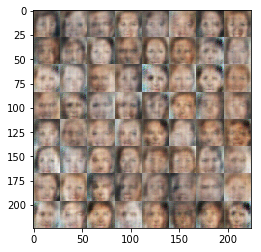

Epoch 1/1... Discriminator Loss: 0.0154... Generator Loss: 7.4790
Epoch 1/1... Discriminator Loss: 0.0994... Generator Loss: 3.0106
Epoch 1/1... Discriminator Loss: 0.0108... Generator Loss: 7.9114
Epoch 1/1... Discriminator Loss: 0.0293... Generator Loss: 4.7295
Epoch 1/1... Discriminator Loss: 0.0804... Generator Loss: 2.9722
Epoch 1/1... Discriminator Loss: 0.0383... Generator Loss: 4.5921
Epoch 1/1... Discriminator Loss: 1.4848... Generator Loss: 0.3134
Epoch 1/1... Discriminator Loss: 3.0736... Generator Loss: 7.1812
Epoch 1/1... Discriminator Loss: 0.1839... Generator Loss: 5.3543
Epoch 1/1... Discriminator Loss: 0.0573... Generator Loss: 5.5225


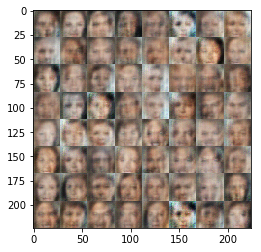

Epoch 1/1... Discriminator Loss: 2.5754... Generator Loss: 0.1124
Epoch 1/1... Discriminator Loss: 0.8423... Generator Loss: 7.5318
Epoch 1/1... Discriminator Loss: 0.1973... Generator Loss: 3.5545
Epoch 1/1... Discriminator Loss: 0.0917... Generator Loss: 4.1643
Epoch 1/1... Discriminator Loss: 0.0495... Generator Loss: 4.7056
Epoch 1/1... Discriminator Loss: 2.4608... Generator Loss: 0.1239
Epoch 1/1... Discriminator Loss: 0.8672... Generator Loss: 8.8591
Epoch 1/1... Discriminator Loss: 0.3614... Generator Loss: 3.7244
Epoch 1/1... Discriminator Loss: 0.0679... Generator Loss: 7.1780
Epoch 1/1... Discriminator Loss: 0.0336... Generator Loss: 5.8506


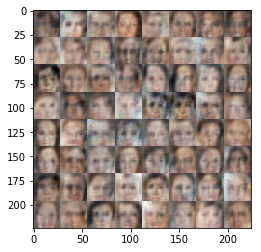

Epoch 1/1... Discriminator Loss: 1.0935... Generator Loss: 0.5397
Epoch 1/1... Discriminator Loss: 0.2495... Generator Loss: 9.0651
Epoch 1/1... Discriminator Loss: 0.2676... Generator Loss: 7.6042
Epoch 1/1... Discriminator Loss: 0.1467... Generator Loss: 3.2422
Epoch 1/1... Discriminator Loss: 0.0492... Generator Loss: 6.9934
Epoch 1/1... Discriminator Loss: 0.0668... Generator Loss: 3.9603
Epoch 1/1... Discriminator Loss: 0.3997... Generator Loss: 1.3859
Epoch 1/1... Discriminator Loss: 0.1106... Generator Loss: 3.3321
Epoch 1/1... Discriminator Loss: 0.1565... Generator Loss: 9.3827
Epoch 1/1... Discriminator Loss: 0.0793... Generator Loss: 8.3108


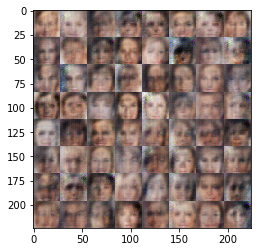

Epoch 1/1... Discriminator Loss: 0.1513... Generator Loss: 2.6610
Epoch 1/1... Discriminator Loss: 0.0358... Generator Loss: 6.0606
Epoch 1/1... Discriminator Loss: 0.1531... Generator Loss: 2.3782
Epoch 1/1... Discriminator Loss: 0.0595... Generator Loss: 4.3101
Epoch 1/1... Discriminator Loss: 0.3456... Generator Loss: 1.4753
Epoch 1/1... Discriminator Loss: 0.1314... Generator Loss: 5.0213
Epoch 1/1... Discriminator Loss: 0.2164... Generator Loss: 3.0067
Epoch 1/1... Discriminator Loss: 0.0829... Generator Loss: 9.7062
Epoch 1/1... Discriminator Loss: 0.0444... Generator Loss: 7.7980
Epoch 1/1... Discriminator Loss: 0.3536... Generator Loss: 1.4809


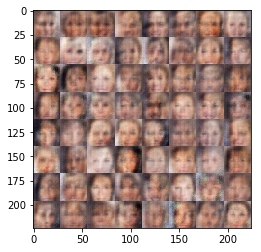

Epoch 1/1... Discriminator Loss: 0.0569... Generator Loss: 6.2890
Epoch 1/1... Discriminator Loss: 0.1027... Generator Loss: 3.3255
Epoch 1/1... Discriminator Loss: 0.3452... Generator Loss: 1.5387
Epoch 1/1... Discriminator Loss: 0.1884... Generator Loss: 9.5121
Epoch 1/1... Discriminator Loss: 0.1232... Generator Loss: 3.7114
Epoch 1/1... Discriminator Loss: 0.0432... Generator Loss: 9.6115
Epoch 1/1... Discriminator Loss: 0.0285... Generator Loss: 8.5959
Epoch 1/1... Discriminator Loss: 0.0610... Generator Loss: 3.4537
Epoch 1/1... Discriminator Loss: 0.0304... Generator Loss: 4.2127
Epoch 1/1... Discriminator Loss: 0.6289... Generator Loss: 1.0294


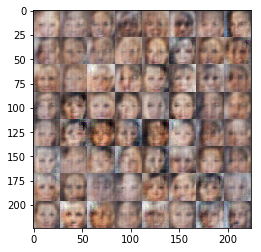

Epoch 1/1... Discriminator Loss: 0.5411... Generator Loss: 10.9726
Epoch 1/1... Discriminator Loss: 0.3030... Generator Loss: 9.4759
Epoch 1/1... Discriminator Loss: 0.0635... Generator Loss: 5.7654
Epoch 1/1... Discriminator Loss: 0.0242... Generator Loss: 5.8377
Epoch 1/1... Discriminator Loss: 0.0278... Generator Loss: 5.0718
Epoch 1/1... Discriminator Loss: 0.3036... Generator Loss: 1.8383
Epoch 1/1... Discriminator Loss: 0.0305... Generator Loss: 6.8620
Epoch 1/1... Discriminator Loss: 0.5641... Generator Loss: 1.0659
Epoch 1/1... Discriminator Loss: 0.1202... Generator Loss: 8.3929
Epoch 1/1... Discriminator Loss: 0.1455... Generator Loss: 5.9473


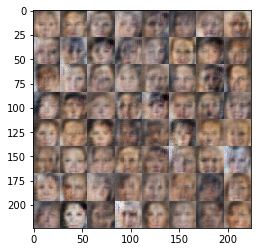

Epoch 1/1... Discriminator Loss: 0.1041... Generator Loss: 3.5557
Epoch 1/1... Discriminator Loss: 0.0435... Generator Loss: 8.2017
Epoch 1/1... Discriminator Loss: 0.0437... Generator Loss: 7.2370
Epoch 1/1... Discriminator Loss: 0.0376... Generator Loss: 4.7034
Epoch 1/1... Discriminator Loss: 0.7805... Generator Loss: 0.7296
Epoch 1/1... Discriminator Loss: 0.3119... Generator Loss: 11.1233
Epoch 1/1... Discriminator Loss: 0.1913... Generator Loss: 10.5357
Epoch 1/1... Discriminator Loss: 0.0562... Generator Loss: 6.8637
Epoch 1/1... Discriminator Loss: 0.0224... Generator Loss: 6.3868
Epoch 1/1... Discriminator Loss: 0.0288... Generator Loss: 5.0309


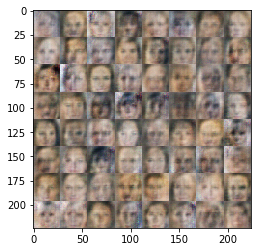

Epoch 1/1... Discriminator Loss: 0.0313... Generator Loss: 4.7618
Epoch 1/1... Discriminator Loss: 0.2775... Generator Loss: 1.6617
Epoch 1/1... Discriminator Loss: 0.0313... Generator Loss: 8.5356
Epoch 1/1... Discriminator Loss: 0.0446... Generator Loss: 4.9659
Epoch 1/1... Discriminator Loss: 0.0369... Generator Loss: 7.0083
Epoch 1/1... Discriminator Loss: 0.1225... Generator Loss: 2.7623
Epoch 1/1... Discriminator Loss: 0.0414... Generator Loss: 7.8526
Epoch 1/1... Discriminator Loss: 0.0268... Generator Loss: 6.2597
Epoch 1/1... Discriminator Loss: 0.0413... Generator Loss: 4.9438
Epoch 1/1... Discriminator Loss: 0.0536... Generator Loss: 3.6984


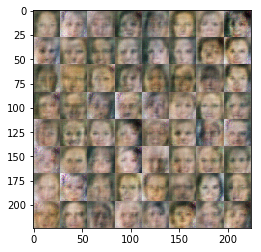

Epoch 1/1... Discriminator Loss: 0.1473... Generator Loss: 2.3825
Epoch 1/1... Discriminator Loss: 0.0505... Generator Loss: 5.4430
Epoch 1/1... Discriminator Loss: 0.7755... Generator Loss: 0.7536
Epoch 1/1... Discriminator Loss: 0.5151... Generator Loss: 8.6063
Epoch 1/1... Discriminator Loss: 0.1357... Generator Loss: 5.3168
Epoch 1/1... Discriminator Loss: 0.0496... Generator Loss: 4.3356
Epoch 1/1... Discriminator Loss: 0.1458... Generator Loss: 2.4794
Epoch 1/1... Discriminator Loss: 0.0450... Generator Loss: 9.1159
Epoch 1/1... Discriminator Loss: 0.0308... Generator Loss: 7.0297
Epoch 1/1... Discriminator Loss: 0.0435... Generator Loss: 3.9544


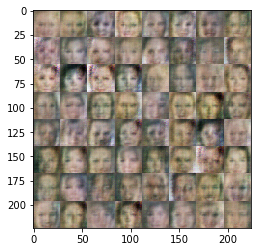

Epoch 1/1... Discriminator Loss: 0.0164... Generator Loss: 8.1338
Epoch 1/1... Discriminator Loss: 0.0305... Generator Loss: 5.0650
Epoch 1/1... Discriminator Loss: 0.6050... Generator Loss: 0.9138
Epoch 1/1... Discriminator Loss: 0.4857... Generator Loss: 8.0969
Epoch 1/1... Discriminator Loss: 0.1378... Generator Loss: 4.5967
Epoch 1/1... Discriminator Loss: 0.0399... Generator Loss: 8.3230
Epoch 1/1... Discriminator Loss: 0.0248... Generator Loss: 6.6548
Epoch 1/1... Discriminator Loss: 1.2100... Generator Loss: 0.6142
Epoch 1/1... Discriminator Loss: 0.7334... Generator Loss: 12.0861
Epoch 1/1... Discriminator Loss: 0.1523... Generator Loss: 10.9951


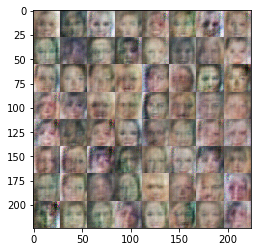

Epoch 1/1... Discriminator Loss: 0.0394... Generator Loss: 10.7139
Epoch 1/1... Discriminator Loss: 0.0267... Generator Loss: 9.5948
Epoch 1/1... Discriminator Loss: 0.0134... Generator Loss: 7.4925
Epoch 1/1... Discriminator Loss: 0.0093... Generator Loss: 6.6542
Epoch 1/1... Discriminator Loss: 0.0424... Generator Loss: 3.6892
Epoch 1/1... Discriminator Loss: 0.0499... Generator Loss: 3.6689
Epoch 1/1... Discriminator Loss: 0.0082... Generator Loss: 6.9358
Epoch 1/1... Discriminator Loss: 0.0123... Generator Loss: 5.8518
Epoch 1/1... Discriminator Loss: 0.3106... Generator Loss: 1.9409
Epoch 1/1... Discriminator Loss: 0.0127... Generator Loss: 7.4812


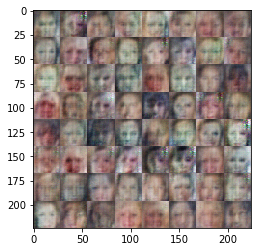

Epoch 1/1... Discriminator Loss: 0.0267... Generator Loss: 6.2359
Epoch 1/1... Discriminator Loss: 0.0697... Generator Loss: 3.4810
Epoch 1/1... Discriminator Loss: 0.0576... Generator Loss: 4.2045
Epoch 1/1... Discriminator Loss: 1.8555... Generator Loss: 0.2303
Epoch 1/1... Discriminator Loss: 0.7878... Generator Loss: 9.0717
Epoch 1/1... Discriminator Loss: 0.1453... Generator Loss: 6.4654
Epoch 1/1... Discriminator Loss: 0.2262... Generator Loss: 2.0881
Epoch 1/1... Discriminator Loss: 0.0555... Generator Loss: 9.0199
Epoch 1/1... Discriminator Loss: 0.0231... Generator Loss: 8.8426
Epoch 1/1... Discriminator Loss: 0.0161... Generator Loss: 7.7247


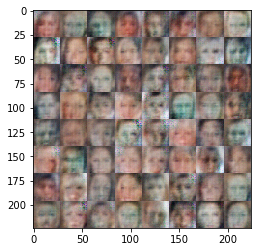

Epoch 1/1... Discriminator Loss: 0.0126... Generator Loss: 6.1425
Epoch 1/1... Discriminator Loss: 0.0702... Generator Loss: 3.4798
Epoch 1/1... Discriminator Loss: 0.0546... Generator Loss: 3.7508
Epoch 1/1... Discriminator Loss: 0.0552... Generator Loss: 3.6375
Epoch 1/1... Discriminator Loss: 0.0172... Generator Loss: 5.3295
Epoch 1/1... Discriminator Loss: 0.0496... Generator Loss: 3.9678
Epoch 1/1... Discriminator Loss: 0.2103... Generator Loss: 2.0197
Epoch 1/1... Discriminator Loss: 0.0692... Generator Loss: 5.9199
Epoch 1/1... Discriminator Loss: 1.6782... Generator Loss: 0.3175
Epoch 1/1... Discriminator Loss: 2.9904... Generator Loss: 9.4390


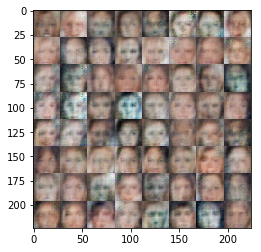

Epoch 1/1... Discriminator Loss: 0.1495... Generator Loss: 2.7784
Epoch 1/1... Discriminator Loss: 0.0621... Generator Loss: 5.5178
Epoch 1/1... Discriminator Loss: 0.3236... Generator Loss: 1.6693
Epoch 1/1... Discriminator Loss: 0.0412... Generator Loss: 7.7418
Epoch 1/1... Discriminator Loss: 0.0517... Generator Loss: 5.5830
Epoch 1/1... Discriminator Loss: 0.0311... Generator Loss: 4.6071
Epoch 1/1... Discriminator Loss: 0.0301... Generator Loss: 5.2869
Epoch 1/1... Discriminator Loss: 4.0047... Generator Loss: 0.0218
Epoch 1/1... Discriminator Loss: 2.1777... Generator Loss: 10.6064
Epoch 1/1... Discriminator Loss: 0.3426... Generator Loss: 8.4280


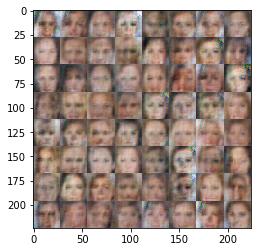

Epoch 1/1... Discriminator Loss: 0.0560... Generator Loss: 4.5015
Epoch 1/1... Discriminator Loss: 0.1799... Generator Loss: 2.4314
Epoch 1/1... Discriminator Loss: 0.0143... Generator Loss: 7.3235
Epoch 1/1... Discriminator Loss: 0.0261... Generator Loss: 6.8736
Epoch 1/1... Discriminator Loss: 1.0056... Generator Loss: 0.6964
Epoch 1/1... Discriminator Loss: 0.6079... Generator Loss: 7.6353
Epoch 1/1... Discriminator Loss: 0.1005... Generator Loss: 3.3559
Epoch 1/1... Discriminator Loss: 0.0492... Generator Loss: 5.1625
Epoch 1/1... Discriminator Loss: 2.6949... Generator Loss: 0.0905
Epoch 1/1... Discriminator Loss: 2.2159... Generator Loss: 9.2736


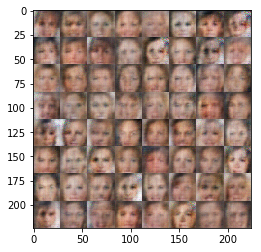

Epoch 1/1... Discriminator Loss: 0.1817... Generator Loss: 3.0322
Epoch 1/1... Discriminator Loss: 0.0306... Generator Loss: 7.7325
Epoch 1/1... Discriminator Loss: 0.0480... Generator Loss: 4.3786
Epoch 1/1... Discriminator Loss: 0.0247... Generator Loss: 5.8788
Epoch 1/1... Discriminator Loss: 1.0587... Generator Loss: 0.5517
Epoch 1/1... Discriminator Loss: 0.3619... Generator Loss: 3.8356
Epoch 1/1... Discriminator Loss: 0.1861... Generator Loss: 6.9526
Epoch 1/1... Discriminator Loss: 0.1501... Generator Loss: 2.5968
Epoch 1/1... Discriminator Loss: 0.0403... Generator Loss: 5.9784
Epoch 1/1... Discriminator Loss: 0.4819... Generator Loss: 1.3136


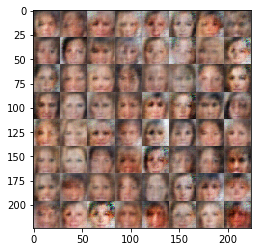

Epoch 1/1... Discriminator Loss: 0.1238... Generator Loss: 6.7638
Epoch 1/1... Discriminator Loss: 0.1780... Generator Loss: 3.5143
Epoch 1/1... Discriminator Loss: 0.0712... Generator Loss: 6.0231
Epoch 1/1... Discriminator Loss: 0.2917... Generator Loss: 1.6463
Epoch 1/1... Discriminator Loss: 0.1004... Generator Loss: 3.7500
Epoch 1/1... Discriminator Loss: 0.0620... Generator Loss: 5.3182
Epoch 1/1... Discriminator Loss: 0.0497... Generator Loss: 9.8247
Epoch 1/1... Discriminator Loss: 0.0262... Generator Loss: 8.7953
Epoch 1/1... Discriminator Loss: 0.3929... Generator Loss: 1.3616
Epoch 1/1... Discriminator Loss: 0.0356... Generator Loss: 9.9185


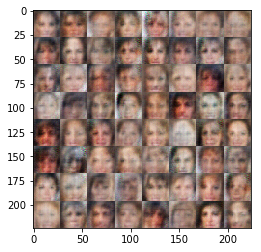

Epoch 1/1... Discriminator Loss: 0.0389... Generator Loss: 10.1445
Epoch 1/1... Discriminator Loss: 0.0274... Generator Loss: 8.6848
Epoch 1/1... Discriminator Loss: 0.0352... Generator Loss: 5.9468
Epoch 1/1... Discriminator Loss: 0.2324... Generator Loss: 1.8755
Epoch 1/1... Discriminator Loss: 0.0432... Generator Loss: 5.8921
Epoch 1/1... Discriminator Loss: 0.1774... Generator Loss: 2.1967
Epoch 1/1... Discriminator Loss: 0.0583... Generator Loss: 4.5911
Epoch 1/1... Discriminator Loss: 0.0428... Generator Loss: 5.5560
Epoch 1/1... Discriminator Loss: 0.0587... Generator Loss: 5.5917
Epoch 1/1... Discriminator Loss: 0.2770... Generator Loss: 1.7242


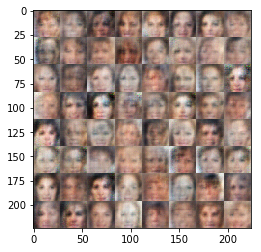

Epoch 1/1... Discriminator Loss: 0.0612... Generator Loss: 8.4384
Epoch 1/1... Discriminator Loss: 0.0712... Generator Loss: 5.0857
Epoch 1/1... Discriminator Loss: 0.0535... Generator Loss: 6.0271
Epoch 1/1... Discriminator Loss: 0.3354... Generator Loss: 1.5187
Epoch 1/1... Discriminator Loss: 0.0441... Generator Loss: 7.4735
Epoch 1/1... Discriminator Loss: 0.1599... Generator Loss: 2.4191
Epoch 1/1... Discriminator Loss: 0.0474... Generator Loss: 5.4784
Epoch 1/1... Discriminator Loss: 0.4061... Generator Loss: 1.2576
Epoch 1/1... Discriminator Loss: 0.1849... Generator Loss: 6.9290
Epoch 1/1... Discriminator Loss: 0.1154... Generator Loss: 5.1168


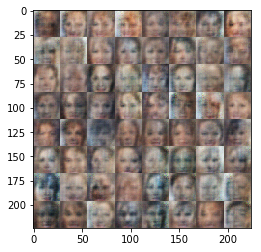

Epoch 1/1... Discriminator Loss: 0.1691... Generator Loss: 2.4159
Epoch 1/1... Discriminator Loss: 0.0367... Generator Loss: 9.8125
Epoch 1/1... Discriminator Loss: 0.0428... Generator Loss: 6.7864
Epoch 1/1... Discriminator Loss: 0.0384... Generator Loss: 5.8658
Epoch 1/1... Discriminator Loss: 1.3374... Generator Loss: 0.3736
Epoch 1/1... Discriminator Loss: 1.8114... Generator Loss: 6.1277
Epoch 1/1... Discriminator Loss: 0.1343... Generator Loss: 6.1869
Epoch 1/1... Discriminator Loss: 0.2462... Generator Loss: 2.1859
Epoch 1/1... Discriminator Loss: 0.0343... Generator Loss: 7.2802
Epoch 1/1... Discriminator Loss: 0.1002... Generator Loss: 3.0678


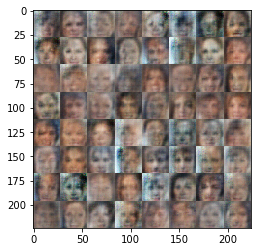

Epoch 1/1... Discriminator Loss: 0.0376... Generator Loss: 6.4654
Epoch 1/1... Discriminator Loss: 0.0840... Generator Loss: 3.2346
Epoch 1/1... Discriminator Loss: 0.0829... Generator Loss: 3.0418
Epoch 1/1... Discriminator Loss: 0.1956... Generator Loss: 2.0786
Epoch 1/1... Discriminator Loss: 0.0479... Generator Loss: 5.2090
Epoch 1/1... Discriminator Loss: 0.6044... Generator Loss: 0.9431
Epoch 1/1... Discriminator Loss: 0.4320... Generator Loss: 9.3917
Epoch 1/1... Discriminator Loss: 0.0970... Generator Loss: 4.4993
Epoch 1/1... Discriminator Loss: 0.0470... Generator Loss: 4.7657
Epoch 1/1... Discriminator Loss: 0.1430... Generator Loss: 2.4805


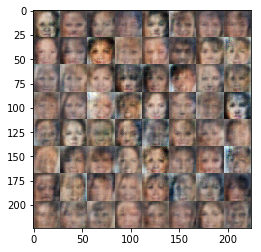

Epoch 1/1... Discriminator Loss: 0.0229... Generator Loss: 9.8495
Epoch 1/1... Discriminator Loss: 0.0210... Generator Loss: 9.4485
Epoch 1/1... Discriminator Loss: 0.0377... Generator Loss: 4.6726
Epoch 1/1... Discriminator Loss: 0.0171... Generator Loss: 7.5981
Epoch 1/1... Discriminator Loss: 0.3795... Generator Loss: 1.4200
Epoch 1/1... Discriminator Loss: 0.1181... Generator Loss: 7.0644
Epoch 1/1... Discriminator Loss: 0.1557... Generator Loss: 3.3295
Epoch 1/1... Discriminator Loss: 0.0791... Generator Loss: 5.3585
Epoch 1/1... Discriminator Loss: 0.0486... Generator Loss: 5.3873
Epoch 1/1... Discriminator Loss: 0.0271... Generator Loss: 6.6662


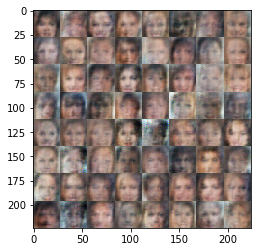

Epoch 1/1... Discriminator Loss: 1.0161... Generator Loss: 0.5733
Epoch 1/1... Discriminator Loss: 0.2739... Generator Loss: 10.9963
Epoch 1/1... Discriminator Loss: 0.1975... Generator Loss: 10.2284
Epoch 1/1... Discriminator Loss: 0.0533... Generator Loss: 8.1171
Epoch 1/1... Discriminator Loss: 0.2452... Generator Loss: 1.8743
Epoch 1/1... Discriminator Loss: 0.0294... Generator Loss: 8.5560
Epoch 1/1... Discriminator Loss: 0.0255... Generator Loss: 5.6467
Epoch 1/1... Discriminator Loss: 0.2113... Generator Loss: 1.9647
Epoch 1/1... Discriminator Loss: 0.0389... Generator Loss: 8.9631
Epoch 1/1... Discriminator Loss: 0.0547... Generator Loss: 7.7622


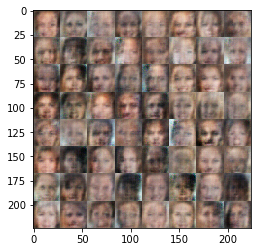

Epoch 1/1... Discriminator Loss: 0.0649... Generator Loss: 3.5747
Epoch 1/1... Discriminator Loss: 0.7946... Generator Loss: 0.7286
Epoch 1/1... Discriminator Loss: 0.4321... Generator Loss: 11.6837
Epoch 1/1... Discriminator Loss: 0.2421... Generator Loss: 11.2798
Epoch 1/1... Discriminator Loss: 0.0526... Generator Loss: 10.0627
Epoch 1/1... Discriminator Loss: 0.0273... Generator Loss: 8.2901
Epoch 1/1... Discriminator Loss: 0.0295... Generator Loss: 5.2749
Epoch 1/1... Discriminator Loss: 0.4769... Generator Loss: 1.4116
Epoch 1/1... Discriminator Loss: 0.0467... Generator Loss: 6.9095
Epoch 1/1... Discriminator Loss: 0.1190... Generator Loss: 3.6430


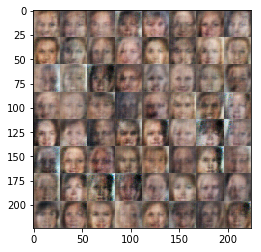

Epoch 1/1... Discriminator Loss: 0.0579... Generator Loss: 5.6983
Epoch 1/1... Discriminator Loss: 0.5119... Generator Loss: 1.1567
Epoch 1/1... Discriminator Loss: 0.2777... Generator Loss: 9.8289
Epoch 1/1... Discriminator Loss: 0.1295... Generator Loss: 9.2918
Epoch 1/1... Discriminator Loss: 0.0570... Generator Loss: 5.1807
Epoch 1/1... Discriminator Loss: 0.0566... Generator Loss: 4.1532
Epoch 1/1... Discriminator Loss: 0.0208... Generator Loss: 6.1461
Epoch 1/1... Discriminator Loss: 0.4709... Generator Loss: 1.2132
Epoch 1/1... Discriminator Loss: 0.0378... Generator Loss: 6.6790
Epoch 1/1... Discriminator Loss: 0.0644... Generator Loss: 4.7551


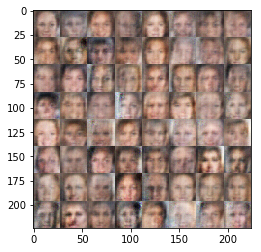

Epoch 1/1... Discriminator Loss: 0.0629... Generator Loss: 3.9270
Epoch 1/1... Discriminator Loss: 0.0788... Generator Loss: 4.2384
Epoch 1/1... Discriminator Loss: 0.0617... Generator Loss: 4.4867
Epoch 1/1... Discriminator Loss: 0.0324... Generator Loss: 9.1000
Epoch 1/1... Discriminator Loss: 0.0932... Generator Loss: 2.8619
Epoch 1/1... Discriminator Loss: 0.0245... Generator Loss: 8.5441
Epoch 1/1... Discriminator Loss: 0.0270... Generator Loss: 6.3253
Epoch 1/1... Discriminator Loss: 0.0618... Generator Loss: 3.3378
Epoch 1/1... Discriminator Loss: 0.0177... Generator Loss: 9.7947
Epoch 1/1... Discriminator Loss: 0.0166... Generator Loss: 8.3440


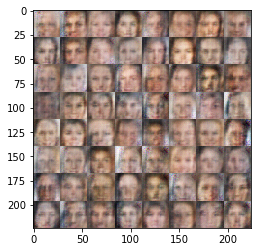

Epoch 1/1... Discriminator Loss: 0.0444... Generator Loss: 4.3789
Epoch 1/1... Discriminator Loss: 0.0306... Generator Loss: 4.1801
Epoch 1/1... Discriminator Loss: 0.0336... Generator Loss: 5.0958
Epoch 1/1... Discriminator Loss: 1.6394... Generator Loss: 0.2672
Epoch 1/1... Discriminator Loss: 2.1780... Generator Loss: 7.3632
Epoch 1/1... Discriminator Loss: 0.0916... Generator Loss: 3.5060
Epoch 1/1... Discriminator Loss: 0.0475... Generator Loss: 4.8441
Epoch 1/1... Discriminator Loss: 0.0396... Generator Loss: 6.0083
Epoch 1/1... Discriminator Loss: 2.3627... Generator Loss: 0.1641
Epoch 1/1... Discriminator Loss: 2.9425... Generator Loss: 5.5919


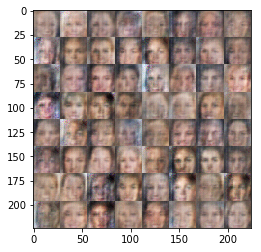

Epoch 1/1... Discriminator Loss: 0.3038... Generator Loss: 1.8191
Epoch 1/1... Discriminator Loss: 0.1384... Generator Loss: 6.7798
Epoch 1/1... Discriminator Loss: 0.1202... Generator Loss: 4.9114
Epoch 1/1... Discriminator Loss: 0.5318... Generator Loss: 1.1812
Epoch 1/1... Discriminator Loss: 0.1004... Generator Loss: 6.3142
Epoch 1/1... Discriminator Loss: 0.1178... Generator Loss: 5.1899
Epoch 1/1... Discriminator Loss: 0.0538... Generator Loss: 5.2538
Epoch 1/1... Discriminator Loss: 0.1281... Generator Loss: 2.5985
Epoch 1/1... Discriminator Loss: 0.0240... Generator Loss: 6.2866
Epoch 1/1... Discriminator Loss: 1.2273... Generator Loss: 0.4384


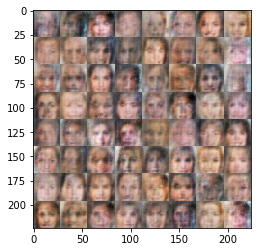

Epoch 1/1... Discriminator Loss: 0.6132... Generator Loss: 9.2025
Epoch 1/1... Discriminator Loss: 0.1352... Generator Loss: 6.8386
Epoch 1/1... Discriminator Loss: 0.7380... Generator Loss: 0.8009
Epoch 1/1... Discriminator Loss: 0.3054... Generator Loss: 7.9519
Epoch 1/1... Discriminator Loss: 0.1351... Generator Loss: 5.7492
Epoch 1/1... Discriminator Loss: 0.6738... Generator Loss: 0.8903
Epoch 1/1... Discriminator Loss: 0.1811... Generator Loss: 8.5536
Epoch 1/1... Discriminator Loss: 0.1138... Generator Loss: 5.4087
Epoch 1/1... Discriminator Loss: 0.0555... Generator Loss: 4.8536
Epoch 1/1... Discriminator Loss: 0.1817... Generator Loss: 2.5738


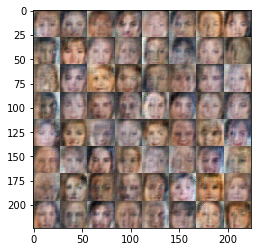

Epoch 1/1... Discriminator Loss: 0.0339... Generator Loss: 12.4579
Epoch 1/1... Discriminator Loss: 0.0255... Generator Loss: 12.4305
Epoch 1/1... Discriminator Loss: 0.0208... Generator Loss: 10.3702
Epoch 1/1... Discriminator Loss: 0.0265... Generator Loss: 5.5599
Epoch 1/1... Discriminator Loss: 0.0156... Generator Loss: 5.9293
Epoch 1/1... Discriminator Loss: 0.0205... Generator Loss: 4.8980
Epoch 1/1... Discriminator Loss: 0.0774... Generator Loss: 2.9744
Epoch 1/1... Discriminator Loss: 0.0232... Generator Loss: 4.7743
Epoch 1/1... Discriminator Loss: 1.2442... Generator Loss: 0.4178
Epoch 1/1... Discriminator Loss: 1.6481... Generator Loss: 6.7312


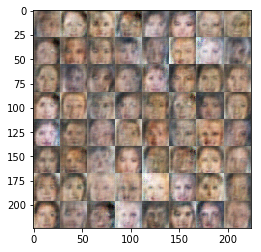

Epoch 1/1... Discriminator Loss: 0.1245... Generator Loss: 3.8428
Epoch 1/1... Discriminator Loss: 0.0396... Generator Loss: 5.9024


IndexError: list index out of range

In [94]:
batch_size = 128
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5

print_every=1
show_every=10
n_images=72

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.